<a href="https://colab.research.google.com/github/rlronan/Tensorflow-GAN-Faces/blob/main/Robert_Ronan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

***NOTE: You must change runtime type to GPU or TPU for this model to run!***

And you must save a copy to your drive in order to edit.

The model requiers around 250 epochs of runtime to converge. Originally run on a NVIDIA GTX 1080. 


In [ ]:
# -*- coding: utf-8 -*-
"""
Created on Thu Nov 12 16:48:39 2020

@author: Robert Ronan
"""

import os
import time
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np

import shutil

from tensorflow.keras import layers
from tensorflow.keras.layers import *
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.models import Sequential, Model

import sklearn
import sklearn.datasets
#%% Import Data
faces = sklearn.datasets.fetch_lfw_people(resize=0.5, color=True)


X = faces.images

def scale_x(images):
  """
  Scale images with integer pixel values in [0,255] to real values in [-1,1].
  This zero centers the IMAGE, not the individual features.
  """
  images = (images - 127.5) / 127.5
  return images

def inverse_scale_x(images):
  """
  Scale images with real values in [-1,1] to integer pixel values in [0,255]
  This un-zero centers the IMAGE, not the individual features.
  """
  images = (images*127.5) + 127.5
  return images.astype(int)

X = scale_x(X)
NUM_SAMPLES = len(X)

In [ ]:
#%% Hyper-hyper Paramaters:

NOISE_DIM = 128
EPOCHS = 200
BATCH_SIZE = 128

In [ ]:
#WGAN Loss with gradient Penalty. 

## Custom WGAN LOSS code:
def custom_discriminator_loss(critic_output_real, critic_output_fake):
  """
  In the conventional GAN (loss) structure the Generator tries to create
  images that appear real, and the discriminator tries to classify unlabeled
  sets of real an generated images as respectively real and fake.
  In a Wasserstein GAN, instead of attempting a binary classification of images,
  the discriminator, refered to as the 'critic,' tries to maximize the margin between 
  its critiques of fake and real batches
  """
  # Minimize total loss:
  #   total loss = real_loss + fake_loss
  #   total loss = -1*avg(real critique) + avg(fake critique)
  #   want to maximize the real crique value, and minimize the fake critique value
  #   equivalently to seperate the real and fake critique values as much as possible.
  #   Note these values are unbounded

  real_loss = -1 * tf.reduce_mean(critic_output_real) # maximize the real output
  fake_loss = tf.reduce_mean(critic_output_fake)
  total_loss = real_loss + fake_loss
  return real_loss, fake_loss, total_loss

def custom_generator_loss(critic_output_fake, generated_images_eval, custom_mode_collapse_penalty=True):
  """
  WGAN generator loss is negative descriminator fake loss.
  I've added a custom penalty, which you can turn off here 
  (not really here since this is a mock definition). 
  """
  # Generator wants to minimize negative(avg(fake critique))
  #   which means to maximize the fake critique value
  #   this pushes that fake critique value towards the real critique value
  #

  if custom_mode_collapse_penalty:
    batch_average = tf.reduce_mean(generated_images_eval, axis=0, keepdims=True)
    avg_distance = tf.reduce_mean(tf.abs(generated_images_eval - batch_average))
    spread = 1 - avg_distance
    dist = (1 + spread)**2 - 1
    fake_loss = -1*tf.reduce_mean(critic_output_fake)   # negative fake average over batch
    inverse_distance_penalty = (1 - tf.math.sigmoid(fake_loss))*tf.math.abs(fake_loss)*dist*0.1
    loss = fake_loss + inverse_distance_penalty
    return loss, fake_loss, dist, inverse_distance_penalty
  else:
    loss = -1* tf.reduce.mean(critic_output_fake)
    return loss, 0, 0, 0
# WGAN Gradient Penalty:
def interpolated_sample(real_images, fake_images):
  """
  We're going to randomly sample a (1, 62, 47, 3) dim point inbetween
  each pair of real and fake images in the batch
  """
  # rnd_weight is dist to real image, and 1-(dist to the fake image)
  # note this MUST be tf.random rather than np.random
  rnd_weight = tf.random.uniform(shape=(BATCH_SIZE,1,1,1))
  rnd_sample = real_images*rnd_weight + fake_images*(1-rnd_weight)

  return rnd_sample


def custom_gradient_penalty(discriminator_model, real_images, fake_images):
  """
  See Improved Training of Wasserstein GANs:
  https://arxiv.org/pdf/1704.00028.pdf
  """

  rnd_sample = interpolated_sample(real_images, fake_images)
  with tf.GradientTape() as tf_gradient_watcher:
    tf_gradient_watcher.watch(rnd_sample)
    sample_critique = discriminator_model(rnd_sample)
  gradient_wrt_sample = tf_gradient_watcher.gradient(sample_critique, rnd_sample)
  # now we take the l2 norm, subtract 1, then square
  gradient_flattened = tf.reshape(gradient_wrt_sample, shape=(BATCH_SIZE, -1))

  # axis is 1 in the following norm because we want to norm actross examples not atch
  gradient_norm = tf.norm(gradient_flattened, ord='euclidean', axis=1) #equiv to np.norm
  gradient_penalty = tf.math.square(gradient_norm -1)

  #flatten the gradient penalty to a constant:
  gradient_penalty = tf.reduce_mean(gradient_penalty) # equiv to np.mean

  return gradient_penalty



In [ ]:
#%% Define the Discriminator model:

def make_discriminator(D_LAYER=[64,128,256,0], D_DROP=0.5, D_BN=True):
  # Do not include batch size in input shapes 
  d_in = tf.keras.layers.Input(shape=(62,47,3), name='D_in')
  layer = d_in

  layer_num = 1
  layer = layers.Conv2D(filters=D_LAYER[0], kernel_size=5, strides=2, padding='same',
                        name='D_'+ str(layer_num))(layer)
  if D_BN:
    layer = layers.BatchNormalization(axis=3, momentum=0.9, name='D_'+str(layer_num)+'_bn')(layer)
  layer = layers.LeakyReLU(0.3, name='D_' + str(layer_num) + '_act')(layer)
  layer = layers.SpatialDropout2D(D_DROP)(layer)

  layer_num += 1
  layer = layers.Conv2D(filters=D_LAYER[1], kernel_size=5, strides=2, padding='same',
                        name='D_'+ str(layer_num))(layer)
  if D_BN:
    layer = layers.BatchNormalization(axis=3, momentum=0.9, name='D_'+str(layer_num)+'_bn')(layer)
  layer = layers.LeakyReLU(0.3, name='D_' + str(layer_num) + '_act')(layer)
  layer = layers.SpatialDropout2D(D_DROP)(layer)

  layer_num += 1
  layer = layers.Conv2D(filters=D_LAYER[2], kernel_size=5, strides=2, padding='same',
                        name='D_'+ str(layer_num))(layer)
  if D_BN:
    layer = layers.BatchNormalization(axis=3, momentum=0.9, name='D_'+str(layer_num)+'_bn')(layer)
  layer = layers.LeakyReLU(0.3, name='D_' + str(layer_num) + '_act')(layer)
  layer = layers.SpatialDropout2D(D_DROP)(layer)


  layer_num += 1
  if D_LAYER[3] != 0:
    layer = layers.Conv2D(filters=D_LAYER[3], kernel_size=5, strides=2, padding='same',
                          name='D_'+ str(layer_num))(layer)
    if D_BN:
      layer = layers.BatchNormalization(axis=3, momentum=0.9, name='D_'+str(layer_num)+'_bn')(layer)
    layer = layers.LeakyReLU(0.3, name='D_' + str(layer_num) + '_act')(layer)
    layer = layers.SpatialDropout2D(D_DROP)(layer)

    layer_num += 1

  layer = layers.Flatten()(layer)

  layer = layers.Dense(units=128, name='D_'+ str(layer_num))(layer)
  # inttionally no relu here
 
  layer_num += 1
  layer = layers.Dense(units=64, name='D_'+ str(layer_num))(layer)
  # inttionally no relu here

  layer_num += 1
  layer = layers.Dense(units=1, name='D_'+ str(layer_num))(layer)
  # Never relu here
  d_out = layer

  discriminator = Model(inputs=d_in, outputs=d_out, name='discriminator')
  discriminator.summary()
  return discriminator


In [ ]:
#%% Define the Generator model

def make_generator(G_LAYER=[256,128,64], G_DROP=0.5, G_BN=True):
  g_in = tf.keras.layers.Input(shape=(NOISE_DIM), name='G_in') 
  # g_in_rand only exists so that custom_dropout can work in tensorflow.
  # Otherwise it's a (required) unused input  
  #g_in_rand = tf.keras.layers.Input(shape=(62, 47, 3), name='G_in_seed')
  
  layer = g_in
  # We use a fully connected (dense) layer of size p*q*NOISE_DIM
  # so that we could reshape the noise vector of shape (batch_size, noise_dimension)
  # to an image of size (batch_size, p, q, NOISE_DIM), and begin generating
  # larger images.
  layer_num = 1
  layer = layers.Dense(units=4*3*NOISE_DIM, name='G_'+ str(layer_num))(layer)
  layer = layers.ReLU(name='G_' + str(layer_num) + '_act')(layer)
  layer = layers.Reshape((4,3,NOISE_DIM), name='G_reshape')(layer)

  layer_num += 1
  layer = layers.Conv2D(filters=G_LAYER[0], kernel_size=5, strides=1, padding='same',
                          use_bias=False, name='G_'+ str(layer_num))(layer)
  layer = layers.UpSampling2D(name= str(layer_num) +'_up')(layer)
  if G_BN:
    layer = layers.BatchNormalization(axis=3, momentum=0.9, name='G_'+str(layer_num)+'_bn')(layer)

  layer = layers.ReLU(name='G_' + str(layer_num) + '_act')(layer)
  layer = layers.SpatialDropout2D(G_DROP)(layer)

  layer_num += 1
  layer = layers.Conv2D(filters=G_LAYER[1], kernel_size=5, strides=1, padding='same',
                        use_bias=False, name='G_'+ str(layer_num))(layer)
  layer = layers.UpSampling2D(name= str(layer_num) +'_up')(layer)
  if G_BN:
    layer = layers.BatchNormalization(axis=3, momentum=0.9, name='G_'+str(layer_num)+'_bn')(layer)
  layer = layers.ReLU(name='G_' + str(layer_num) + '_act')(layer)
  layer = layers.SpatialDropout2D(G_DROP)(layer)

  layer_num += 1
  layer = layers.Conv2D(filters=G_LAYER[2], kernel_size=5, strides=1, padding='same',
                          use_bias=False, name='G_'+ str(layer_num))(layer)
  layer = layers.UpSampling2D(name= str(layer_num) +'_up')(layer)
  if G_BN:
    layer = layers.BatchNormalization(axis=3, momentum=0.9, name='G_'+str(layer_num)+'_bn')(layer)
  layer = layers.ReLU(name='G_' + str(layer_num) + '_act')(layer)
  layer = layers.SpatialDropout2D(G_DROP)(layer)

  layer_num += 1
  if G_LAYER[3] != 0:
    layer = layers.Conv2D(filters=G_LAYER[3], kernel_size=5, strides=1, padding='same',
                            use_bias=False, name='G_'+ str(layer_num))(layer)
    layer = layers.UpSampling2D(name= str(layer_num) +'_up')(layer)
    if G_BN:
      layer = layers.BatchNormalization(axis=3, momentum=0.9, name='G_'+str(layer_num)+'_bn')(layer)
    layer = layers.ReLU(name='G_' + str(layer_num) + '_act')(layer)
    layer = layers.SpatialDropout2D(G_DROP)(layer)
    layer_num += 1

  layer = layers.Conv2D(filters=G_LAYER[3]//2, kernel_size=5, strides=1, padding='same',
                          use_bias=False, name='G_'+ str(layer_num))(layer)
  layer = layers.ReLU(name='G_' + str(layer_num) + '_act')(layer)

  layer_num += 1
  layer = layers.Conv2D(filters=G_LAYER[3]//4, kernel_size=5, strides=1, padding='same',
                          use_bias=False, name='G_'+ str(layer_num))(layer)
  layer = layers.ReLU(name='G_' + str(layer_num) + '_act')(layer)
  layer_num += 1

  # Note the tanh activation in the last layer because there is no tanh layer in TF.
  layer = layers.Conv2D(filters=3, kernel_size=5, strides=1, padding='same',
                          use_bias=False, activation='tanh', name='G_'+ str(layer_num))(layer)

  g_out = tf.image.resize_with_crop_or_pad(layer, 62, 47)

  generator = Model(inputs=g_in, outputs=g_out, name='generator')
  generator.summary()
  return generator




In [ ]:
#%% Function to generate images during training
#   This is modified tensorflow code
def generate_and_save_images(model, epoch, index, test_input, sample_dir):
  """
  The top two rows of every image are the model in evaluation mode,
  the bottom two rows are the model in training mode (with dropout and batch norm).
  If custom dropout is on, every image has 2/3 of the color channels droped.
  """
  
  # When training is set to False  batchnorm and dropout don't run
  test_input_1 = tf.random.normal([BATCH_SIZE, NOISE_DIM], seed=1)
  test_input_2 = tf.random.normal([BATCH_SIZE, NOISE_DIM], seed=1)

  ##tf.keras.backend.set_learning_phase(0) depreciated and broken
  predictions = model(test_input_1, training=False)
  predictions = predictions.numpy()


  tf.keras.backend.set_learning_phase(1)
  predictions_training = model(test_input_2, training=True)
  predictions_training = predictions_training.numpy()

  predictions = inverse_scale_x(predictions)
  predictions_training = inverse_scale_x(predictions_training)
  fig = plt.figure(figsize=(4,4))

  for i in range(8):
      plt.subplot(4, 4, i+1)
      plt.imshow(predictions[i])
      plt.axis('off')
  for i in range(8):
      plt.subplot(4, 4, 8+i+1)
      plt.imshow(predictions_training[i])
      plt.axis('off')
  #plt.savefig(sample_dir + 'epoch_{:04d}_{}.png'.format(epoch,index))
  plt.show()


In [ ]:
# Define the training loop and image augmentation:

#%% Image Augmentation
datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    # DO NOT FEATUREWISE CENTER
    # DO NOT FEATUREWISE STD NORMALIZE
    rotation_range=20,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

datagen.fit(X)

#%% Training Loop:
# This is partially tensorflow code and partially self-written
def train():
    seed = tf.random.normal([16, NOISE_DIM])
    gen_losses = []
    disc_losses = []
    disc_real_losses = []
    disc_fake_losses = []
    start = time.time()
    for epoch in range(EPOCHS):
      batch_number = 0
      num_batches = NUM_SAMPLES//BATCH_SIZE

      for samples in datagen.flow(X, batch_size=BATCH_SIZE):
        if (epoch == 0) and (batch_number == 0):
          print("Sample of augmented image data")
          samples_save = inverse_scale_x(samples)
          fig = plt.figure(figsize=(4,4))
          print("Top two rows of the figure shows generator in evaluation mode, the bottom two rows show the generator in training mode(with dropout and batch norm). Training mode is what the discriminator sees.")

          for i in range(16):
              plt.subplot(4, 4, i+1)
              plt.imshow(samples_save[i])
              plt.axis('off')

          #plt.savefig(sample_dir + 'augmented_samples.png')
          plt.show()

        gen_loss, disc_loss, disc_loss_real, disc_loss_fake, gen_loss_fake, gen_dist, gen_penalty = train_step(samples)
        gen_losses.append(gen_loss)
        disc_losses.append(disc_loss)
        disc_real_losses.append(disc_loss_real)
        disc_fake_losses.append(disc_loss_fake)
        batch_number += 1
        checkpoint.step.assign_add(1)

        if batch_number % (num_batches//4) == 0:
          print("Epoch: {},\t G Loss: {:.5f},\t D Loss: {:.5f},  D_Real_loss: {:.5f},  D_Fake_loss: {:.5f},\t G_fake_loss {:.5f},\t G_dist: {:.5f},\t G_pen: {:.5f}".format(
            epoch, gen_loss.numpy(), disc_loss.numpy(), disc_loss_real.numpy(), disc_loss_fake.numpy(), gen_loss_fake.numpy(), gen_dist.numpy(), gen_penalty.numpy()))

          generate_and_save_images(generator, epoch, batch_number//(num_batches//4), seed, sample_dir)
        # This must be broken manually since datagen will continue return infinitely many batches
        if  batch_number == num_batches:
          break

        # Save the model every 10 epochs
      if (epoch + 1) % 10 == 0:
        #manager.save()
        print("Epoch: {},\t Generator Loss: {},\t Discriminator Loss: {}".format(epoch, round(gen_loss.numpy(),7), round(disc_loss.numpy(),7)))
        print('Total time to epoch {} is {} min'.format(epoch + 1, (time.time()-start)/60))

    # When the model is done training, plot the Generator loss, 
    #   along with the discriminator loss, and the real and fake Disc losses
    # Note that these plots are for every 50 batch iterations.
    plt.plot(gen_losses[::50])
    plt.ylabel('Generator Loss')
    plt.xlabel('Iteration number/50')
    #plt.savefig(sample_dir + 'Generator_Loss.png')
    plt.show()

    plt.plot(disc_losses[::50])
    plt.ylabel('Discriminator Loss')
    plt.xlabel('Iteration number/50')
    #plt.savefig(sample_dir + 'Discriminator_Loss.png')
    plt.show()
    
    plt.plot(disc_real_losses[::50])
    plt.ylabel('Discriminator Real Loss')
    plt.xlabel('Iteration number/50')
    #plt.savefig(sample_dir + 'Discriminator_Real_Loss.png')
    plt.show()

    plt.plot(disc_fake_losses[::50])
    plt.ylabel('Discriminator Fake Loss')
    plt.xlabel('Iteration number/50')
    #plt.savefig(sample_dir + 'Discriminator_Fake_Loss.png')
    plt.show()


Model: "generator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
G_in (InputLayer)            [(None, 128)]             0         
_________________________________________________________________
G_1 (Dense)                  (None, 1536)              198144    
_________________________________________________________________
G_1_act (ReLU)               (None, 1536)              0         
_________________________________________________________________
G_reshape (Reshape)          (None, 4, 3, 128)         0         
_________________________________________________________________
G_2 (Conv2D)                 (None, 4, 3, 256)         819200    
_________________________________________________________________
2_up (UpSampling2D)          (None, 8, 6, 256)         0         
_________________________________________________________________
G_2_bn (BatchNormalization)  (None, 8, 6, 256)         10

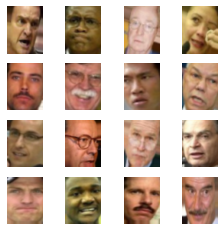

Epoch: 0,	 G Loss: 5.80373,	 D Loss: -40.21947,  D_Real_loss: -32.20484,  D_Fake_loss: -8.01463,	 G_fake_loss 5.79907,	 G_dist: 2.65766,	 G_pen: 0.00466


/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/backend.py:434: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn('`tf.keras.backend.set_learning_phase` is deprecated and '


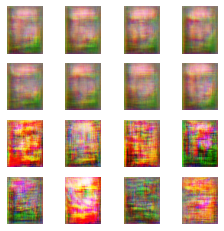

Epoch: 0,	 G Loss: 6.86479,	 D Loss: -35.02913,  D_Real_loss: -29.16912,  D_Fake_loss: -5.86001,	 G_fake_loss 6.86289,	 G_dist: 2.64645,	 G_pen: 0.00190


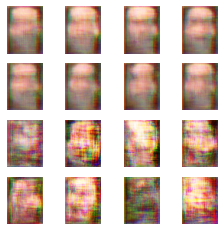

Epoch: 0,	 G Loss: -15.77304,	 D Loss: -33.66870,  D_Real_loss: -53.24404,  D_Fake_loss: 19.57534,	 G_fake_loss -21.44073,	 G_dist: 2.64342,	 G_pen: 5.66769


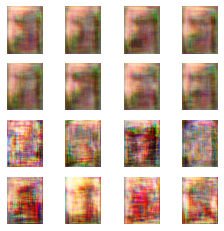

Epoch: 0,	 G Loss: -23.71707,	 D Loss: -21.49425,  D_Real_loss: -46.42218,  D_Fake_loss: 24.92793,	 G_fake_loss -31.92013,	 G_dist: 2.56987,	 G_pen: 8.20306


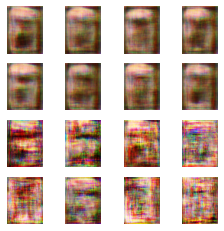

Epoch: 1,	 G Loss: -11.12423,	 D Loss: -24.65087,  D_Real_loss: -39.25256,  D_Fake_loss: 14.60169,	 G_fake_loss -15.03313,	 G_dist: 2.60019,	 G_pen: 3.90890


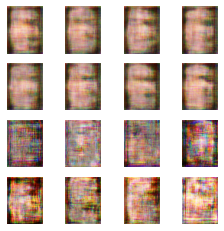

Epoch: 1,	 G Loss: -16.78675,	 D Loss: -22.97414,  D_Real_loss: -48.79733,  D_Fake_loss: 25.82319,	 G_fake_loss -22.75773,	 G_dist: 2.62371,	 G_pen: 5.97098


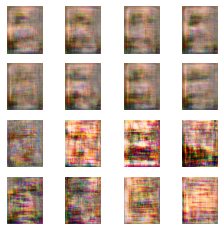

Epoch: 1,	 G Loss: -6.60509,	 D Loss: -24.60659,  D_Real_loss: -35.62119,  D_Fake_loss: 11.01460,	 G_fake_loss -8.96754,	 G_dist: 2.63478,	 G_pen: 2.36245


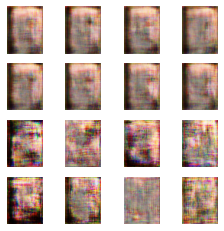

Epoch: 1,	 G Loss: -8.40533,	 D Loss: -26.32588,  D_Real_loss: -39.03613,  D_Fake_loss: 12.71025,	 G_fake_loss -11.44604,	 G_dist: 2.65659,	 G_pen: 3.04071


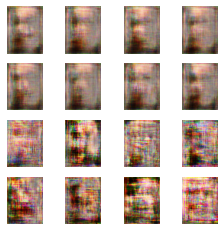

Epoch: 2,	 G Loss: 11.64213,	 D Loss: -29.80830,  D_Real_loss: -10.66094,  D_Fake_loss: -19.14736,	 G_fake_loss 11.64211,	 G_dist: 2.66575,	 G_pen: 0.00003


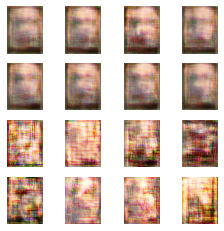

Epoch: 2,	 G Loss: -13.03925,	 D Loss: -23.01975,  D_Real_loss: -37.53944,  D_Fake_loss: 14.51969,	 G_fake_loss -17.59366,	 G_dist: 2.58866,	 G_pen: 4.55441


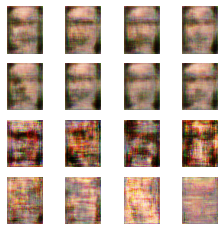

Epoch: 2,	 G Loss: -18.09910,	 D Loss: -29.25864,  D_Real_loss: -55.28148,  D_Fake_loss: 26.02284,	 G_fake_loss -24.52987,	 G_dist: 2.62161,	 G_pen: 6.43078


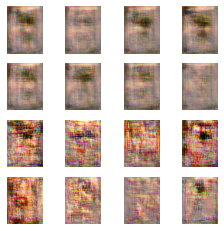

Epoch: 2,	 G Loss: 38.50876,	 D Loss: -31.63514,  D_Real_loss: 9.69246,  D_Fake_loss: -41.32760,	 G_fake_loss 38.50876,	 G_dist: 2.27446,	 G_pen: 0.00000


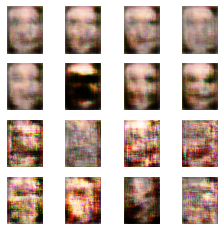

Epoch: 3,	 G Loss: -24.69890,	 D Loss: -24.85619,  D_Real_loss: -53.35798,  D_Fake_loss: 28.50179,	 G_fake_loss -32.52407,	 G_dist: 2.40596,	 G_pen: 7.82517


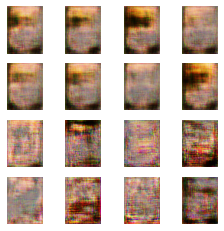

Epoch: 3,	 G Loss: -19.16461,	 D Loss: -29.03257,  D_Real_loss: -58.60202,  D_Fake_loss: 29.56945,	 G_fake_loss -25.83201,	 G_dist: 2.58106,	 G_pen: 6.66740


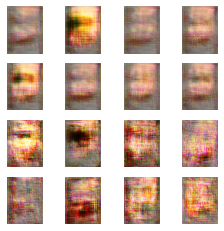

Epoch: 3,	 G Loss: -22.12690,	 D Loss: -25.42746,  D_Real_loss: -52.84557,  D_Fake_loss: 27.41811,	 G_fake_loss -29.39477,	 G_dist: 2.47250,	 G_pen: 7.26787


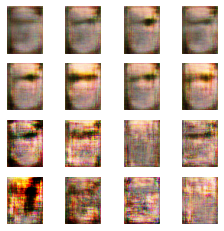

Epoch: 3,	 G Loss: -20.26769,	 D Loss: -25.87246,  D_Real_loss: -55.27010,  D_Fake_loss: 29.39764,	 G_fake_loss -27.32151,	 G_dist: 2.58178,	 G_pen: 7.05382


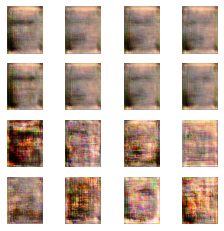

Epoch: 4,	 G Loss: -9.58179,	 D Loss: -29.48285,  D_Real_loss: -41.46432,  D_Fake_loss: 11.98147,	 G_fake_loss -12.95317,	 G_dist: 2.60276,	 G_pen: 3.37139


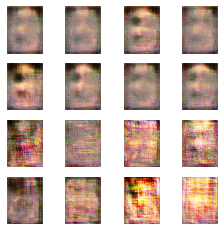

Epoch: 4,	 G Loss: -9.66375,	 D Loss: -28.30307,  D_Real_loss: -43.01499,  D_Fake_loss: 14.71192,	 G_fake_loss -12.74812,	 G_dist: 2.41948,	 G_pen: 3.08437


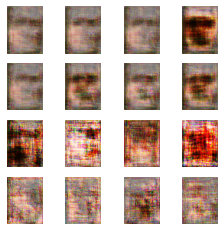

Epoch: 4,	 G Loss: -3.66267,	 D Loss: -25.12306,  D_Real_loss: -32.66018,  D_Fake_loss: 7.53712,	 G_fake_loss -4.85766,	 G_dist: 2.47912,	 G_pen: 1.19499


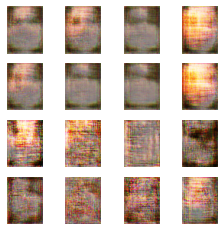

Epoch: 4,	 G Loss: 68.38517,	 D Loss: -28.45950,  D_Real_loss: 30.29688,  D_Fake_loss: -58.75638,	 G_fake_loss 68.38517,	 G_dist: 2.34932,	 G_pen: 0.00000


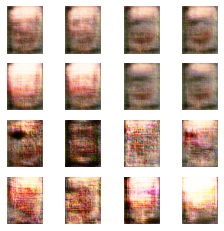

Epoch: 5,	 G Loss: -6.53409,	 D Loss: -22.34021,  D_Real_loss: -23.77032,  D_Fake_loss: 1.43010,	 G_fake_loss -8.45029,	 G_dist: 2.26810,	 G_pen: 1.91620


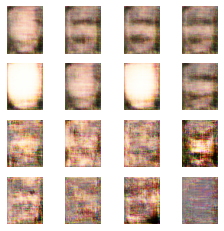

Epoch: 5,	 G Loss: -16.36652,	 D Loss: -26.50974,  D_Real_loss: -48.02924,  D_Fake_loss: 21.51950,	 G_fake_loss -21.91585,	 G_dist: 2.53211,	 G_pen: 5.54933


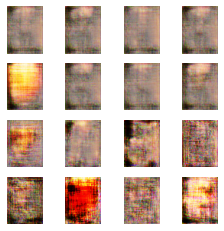

Epoch: 5,	 G Loss: 57.42942,	 D Loss: -24.76844,  D_Real_loss: 31.43511,  D_Fake_loss: -56.20355,	 G_fake_loss 57.42942,	 G_dist: 2.46696,	 G_pen: 0.00000


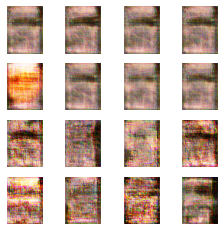

Epoch: 5,	 G Loss: -19.27041,	 D Loss: -23.40050,  D_Real_loss: -46.31561,  D_Fake_loss: 22.91511,	 G_fake_loss -25.04545,	 G_dist: 2.30583,	 G_pen: 5.77504


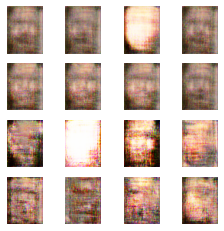

Epoch: 6,	 G Loss: 50.59782,	 D Loss: -28.76641,  D_Real_loss: 28.24067,  D_Fake_loss: -57.00708,	 G_fake_loss 50.59782,	 G_dist: 2.40282,	 G_pen: 0.00000


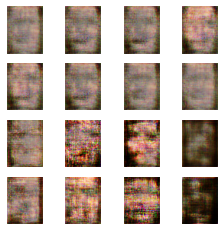

Epoch: 6,	 G Loss: -44.42200,	 D Loss: -21.98558,  D_Real_loss: -79.18214,  D_Fake_loss: 57.19656,	 G_fake_loss -57.83441,	 G_dist: 2.31910,	 G_pen: 13.41240


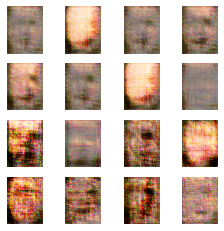

Epoch: 6,	 G Loss: 83.87171,	 D Loss: -19.96217,  D_Real_loss: 54.96142,  D_Fake_loss: -74.92358,	 G_fake_loss 83.87171,	 G_dist: 2.17840,	 G_pen: 0.00000


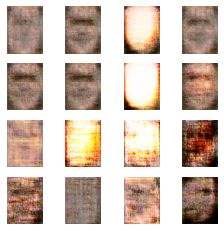

Epoch: 6,	 G Loss: 34.14047,	 D Loss: -19.97026,  D_Real_loss: 18.02949,  D_Fake_loss: -37.99975,	 G_fake_loss 34.14047,	 G_dist: 2.32341,	 G_pen: 0.00000


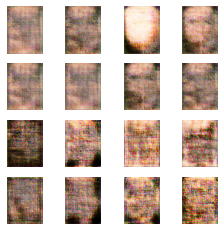

Epoch: 7,	 G Loss: -21.58434,	 D Loss: -18.03664,  D_Real_loss: -48.46077,  D_Fake_loss: 30.42413,	 G_fake_loss -28.30724,	 G_dist: 2.37498,	 G_pen: 6.72290


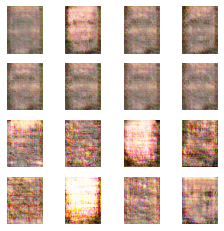

Epoch: 7,	 G Loss: 65.28551,	 D Loss: -19.43313,  D_Real_loss: 42.37837,  D_Fake_loss: -61.81150,	 G_fake_loss 65.28551,	 G_dist: 2.29031,	 G_pen: 0.00000


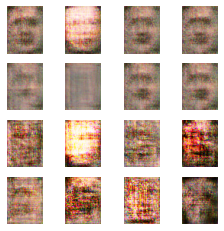

Epoch: 7,	 G Loss: 62.20185,	 D Loss: -23.93889,  D_Real_loss: 46.00318,  D_Fake_loss: -69.94207,	 G_fake_loss 62.20185,	 G_dist: 2.49702,	 G_pen: 0.00000


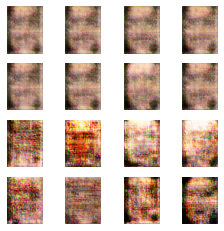

Epoch: 7,	 G Loss: -4.60682,	 D Loss: -27.54691,  D_Real_loss: -30.91121,  D_Fake_loss: 3.36430,	 G_fake_loss -6.16108,	 G_dist: 2.52804,	 G_pen: 1.55427


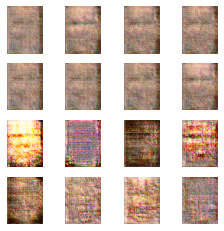

Epoch: 8,	 G Loss: 42.29797,	 D Loss: -19.20013,  D_Real_loss: 27.24706,  D_Fake_loss: -46.44718,	 G_fake_loss 42.29797,	 G_dist: 2.38529,	 G_pen: 0.00000


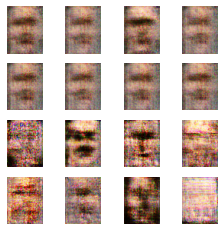

Epoch: 8,	 G Loss: 48.08083,	 D Loss: -21.04522,  D_Real_loss: 26.16706,  D_Fake_loss: -47.21228,	 G_fake_loss 48.08083,	 G_dist: 2.38908,	 G_pen: 0.00000


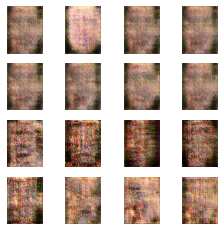

Epoch: 8,	 G Loss: 13.62010,	 D Loss: -18.11788,  D_Real_loss: -9.57328,  D_Fake_loss: -8.54460,	 G_fake_loss 13.62009,	 G_dist: 2.46311,	 G_pen: 0.00000


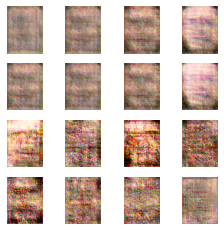

Epoch: 8,	 G Loss: 33.84336,	 D Loss: -25.65831,  D_Real_loss: 10.09672,  D_Fake_loss: -35.75503,	 G_fake_loss 33.84336,	 G_dist: 2.31642,	 G_pen: 0.00000


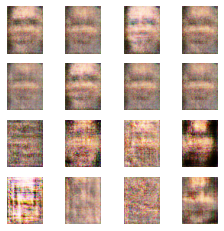

Epoch: 9,	 G Loss: 0.28915,	 D Loss: -16.69067,  D_Real_loss: -12.03864,  D_Fake_loss: -4.65203,	 G_fake_loss 0.26194,	 G_dist: 2.38919,	 G_pen: 0.02722


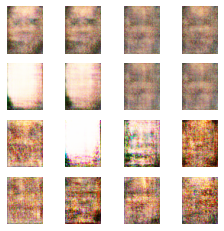

Epoch: 9,	 G Loss: 117.10741,	 D Loss: -20.11819,  D_Real_loss: 90.55608,  D_Fake_loss: -110.67426,	 G_fake_loss 117.10741,	 G_dist: 2.31980,	 G_pen: 0.00000


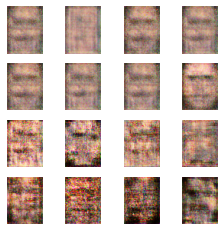

Epoch: 9,	 G Loss: -2.89967,	 D Loss: -18.23528,  D_Real_loss: -20.97279,  D_Fake_loss: 2.73751,	 G_fake_loss -3.82188,	 G_dist: 2.46578,	 G_pen: 0.92221


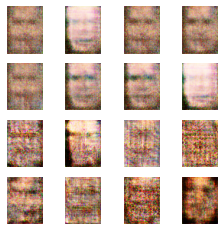

Epoch: 9,	 G Loss: 99.14689,	 D Loss: -17.62463,  D_Real_loss: 73.74541,  D_Fake_loss: -91.37003,	 G_fake_loss 99.14689,	 G_dist: 2.38449,	 G_pen: 0.00000


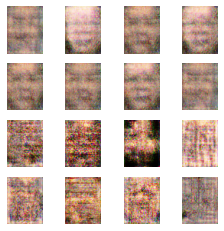

Epoch: 9,	 Generator Loss: 67.12844848632812,	 Discriminator Loss: -15.76540756225586
Total time to epoch 10 is 13.308934462070464 min
Epoch: 10,	 G Loss: 17.91004,	 D Loss: -12.02496,  D_Real_loss: 5.19055,  D_Fake_loss: -17.21551,	 G_fake_loss 17.91004,	 G_dist: 2.47648,	 G_pen: 0.00000


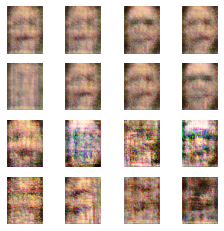

Epoch: 10,	 G Loss: 29.71991,	 D Loss: -16.70480,  D_Real_loss: 11.15635,  D_Fake_loss: -27.86115,	 G_fake_loss 29.71991,	 G_dist: 2.47721,	 G_pen: 0.00000


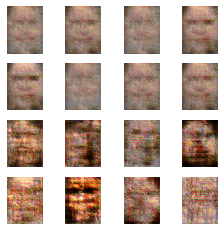

Epoch: 10,	 G Loss: 22.99609,	 D Loss: -16.71169,  D_Real_loss: 11.92409,  D_Fake_loss: -28.63577,	 G_fake_loss 22.99609,	 G_dist: 2.28254,	 G_pen: 0.00000


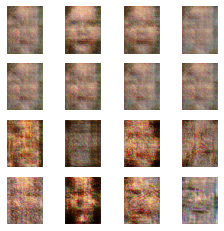

Epoch: 10,	 G Loss: 38.45909,	 D Loss: -15.79786,  D_Real_loss: 20.92307,  D_Fake_loss: -36.72093,	 G_fake_loss 38.45909,	 G_dist: 2.46814,	 G_pen: 0.00000


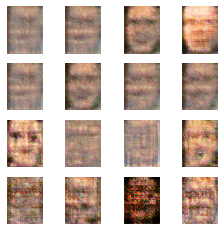

Epoch: 11,	 G Loss: 70.76077,	 D Loss: -15.51191,  D_Real_loss: 53.83818,  D_Fake_loss: -69.35008,	 G_fake_loss 70.76077,	 G_dist: 2.46429,	 G_pen: 0.00000


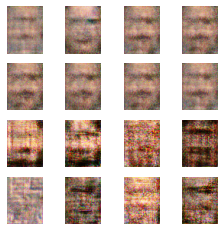

Epoch: 11,	 G Loss: 48.44395,	 D Loss: -15.90568,  D_Real_loss: 35.30634,  D_Fake_loss: -51.21201,	 G_fake_loss 48.44395,	 G_dist: 2.50655,	 G_pen: 0.00000


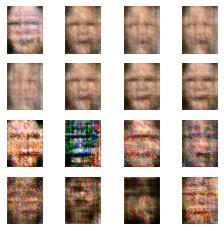

Epoch: 11,	 G Loss: 61.05584,	 D Loss: -14.42353,  D_Real_loss: 46.18821,  D_Fake_loss: -60.61174,	 G_fake_loss 61.05584,	 G_dist: 2.47625,	 G_pen: 0.00000


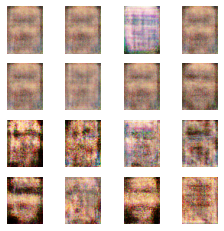

Epoch: 11,	 G Loss: 53.62996,	 D Loss: -16.62344,  D_Real_loss: 38.72127,  D_Fake_loss: -55.34471,	 G_fake_loss 53.62996,	 G_dist: 2.49494,	 G_pen: 0.00000


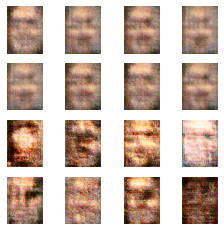

Epoch: 12,	 G Loss: 45.24516,	 D Loss: -12.25206,  D_Real_loss: 28.13775,  D_Fake_loss: -40.38981,	 G_fake_loss 45.24516,	 G_dist: 2.51189,	 G_pen: 0.00000


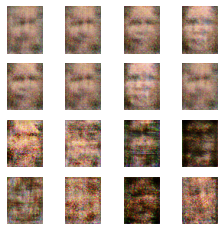

Epoch: 12,	 G Loss: 50.09710,	 D Loss: -16.45016,  D_Real_loss: 32.57832,  D_Fake_loss: -49.02848,	 G_fake_loss 50.09710,	 G_dist: 2.46370,	 G_pen: 0.00000


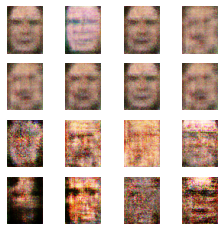

Epoch: 12,	 G Loss: -6.61599,	 D Loss: -23.57182,  D_Real_loss: -19.96123,  D_Fake_loss: -3.61058,	 G_fake_loss -8.73969,	 G_dist: 2.43034,	 G_pen: 2.12370


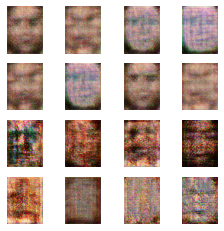

Epoch: 12,	 G Loss: -2.81942,	 D Loss: -19.59568,  D_Real_loss: -22.76386,  D_Fake_loss: 3.16818,	 G_fake_loss -3.78641,	 G_dist: 2.61175,	 G_pen: 0.96699


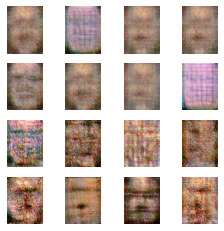

Epoch: 13,	 G Loss: -8.03667,	 D Loss: -11.57903,  D_Real_loss: -18.81464,  D_Fake_loss: 7.23561,	 G_fake_loss -10.43549,	 G_dist: 2.29879,	 G_pen: 2.39882


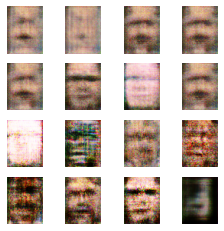

Epoch: 13,	 G Loss: -25.93734,	 D Loss: -15.60722,  D_Real_loss: -48.63947,  D_Fake_loss: 33.03226,	 G_fake_loss -33.58252,	 G_dist: 2.27654,	 G_pen: 7.64518


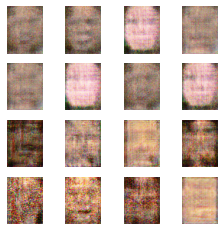

Epoch: 13,	 G Loss: 99.05933,	 D Loss: -19.62403,  D_Real_loss: 78.80560,  D_Fake_loss: -98.42963,	 G_fake_loss 99.05933,	 G_dist: 2.38774,	 G_pen: 0.00000


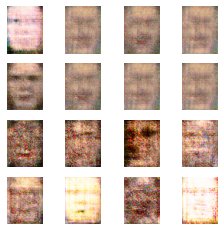

Epoch: 13,	 G Loss: 90.74597,	 D Loss: -14.24163,  D_Real_loss: 77.42574,  D_Fake_loss: -91.66737,	 G_fake_loss 90.74597,	 G_dist: 2.46756,	 G_pen: 0.00000


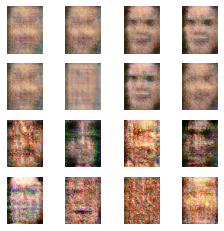

Epoch: 14,	 G Loss: 35.25108,	 D Loss: -12.68912,  D_Real_loss: 23.06234,  D_Fake_loss: -35.75146,	 G_fake_loss 35.25108,	 G_dist: 2.43939,	 G_pen: 0.00000


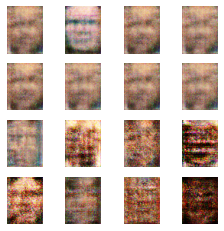

Epoch: 14,	 G Loss: 20.26305,	 D Loss: -11.50731,  D_Real_loss: 9.47679,  D_Fake_loss: -20.98410,	 G_fake_loss 20.26305,	 G_dist: 2.48682,	 G_pen: 0.00000


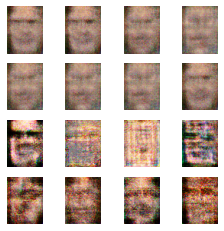

Epoch: 14,	 G Loss: 24.33584,	 D Loss: -11.89114,  D_Real_loss: 4.70248,  D_Fake_loss: -16.59363,	 G_fake_loss 24.33584,	 G_dist: 2.50103,	 G_pen: 0.00000


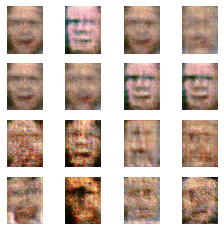

Epoch: 14,	 G Loss: 81.89981,	 D Loss: -18.03143,  D_Real_loss: 67.83185,  D_Fake_loss: -85.86328,	 G_fake_loss 81.89981,	 G_dist: 2.24809,	 G_pen: 0.00000


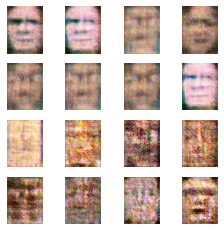

Epoch: 15,	 G Loss: 53.27110,	 D Loss: -14.61760,  D_Real_loss: 43.17683,  D_Fake_loss: -57.79443,	 G_fake_loss 53.27110,	 G_dist: 2.58185,	 G_pen: 0.00000


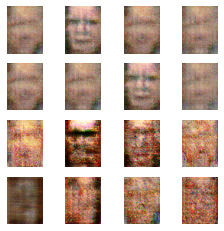

Epoch: 15,	 G Loss: 27.07426,	 D Loss: -11.30055,  D_Real_loss: 13.92642,  D_Fake_loss: -25.22697,	 G_fake_loss 27.07426,	 G_dist: 2.40839,	 G_pen: 0.00000


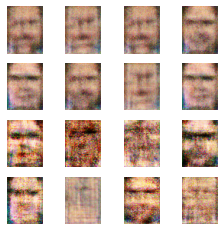

Epoch: 15,	 G Loss: 25.77594,	 D Loss: -12.25720,  D_Real_loss: 11.01086,  D_Fake_loss: -23.26806,	 G_fake_loss 25.77594,	 G_dist: 2.49870,	 G_pen: 0.00000


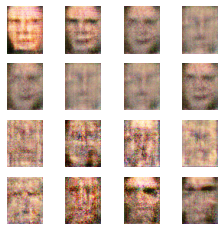

Epoch: 15,	 G Loss: -7.75854,	 D Loss: -14.60386,  D_Real_loss: -25.66655,  D_Fake_loss: 11.06268,	 G_fake_loss -10.28342,	 G_dist: 2.45538,	 G_pen: 2.52489


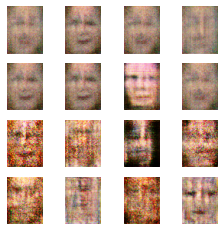

Epoch: 16,	 G Loss: 80.41811,	 D Loss: -14.44733,  D_Real_loss: 65.47074,  D_Fake_loss: -79.91808,	 G_fake_loss 80.41811,	 G_dist: 2.36913,	 G_pen: 0.00000


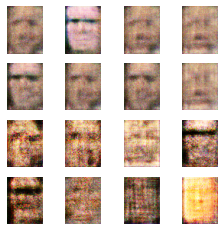

Epoch: 16,	 G Loss: 2.22464,	 D Loss: -12.73177,  D_Real_loss: -13.94149,  D_Fake_loss: 1.20972,	 G_fake_loss 2.16755,	 G_dist: 2.56461,	 G_pen: 0.05709


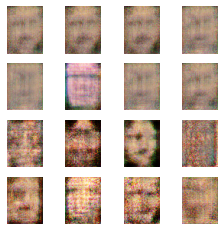

Epoch: 16,	 G Loss: 37.16645,	 D Loss: -12.67309,  D_Real_loss: 26.07642,  D_Fake_loss: -38.74951,	 G_fake_loss 37.16645,	 G_dist: 2.47552,	 G_pen: 0.00000


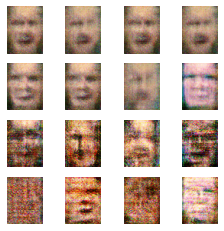

Epoch: 16,	 G Loss: 33.43736,	 D Loss: -11.73446,  D_Real_loss: 18.80988,  D_Fake_loss: -30.54435,	 G_fake_loss 33.43736,	 G_dist: 2.47877,	 G_pen: 0.00000


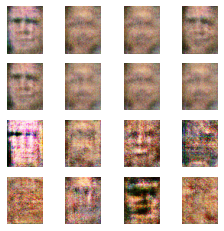

Epoch: 17,	 G Loss: 61.60160,	 D Loss: -10.86964,  D_Real_loss: 48.20299,  D_Fake_loss: -59.07262,	 G_fake_loss 61.60160,	 G_dist: 2.41374,	 G_pen: 0.00000


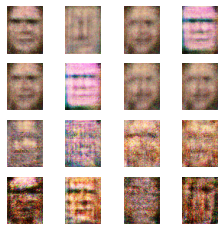

Epoch: 17,	 G Loss: 41.28500,	 D Loss: -13.09912,  D_Real_loss: 33.43441,  D_Fake_loss: -46.53353,	 G_fake_loss 41.28500,	 G_dist: 2.49737,	 G_pen: 0.00000


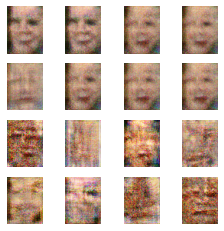

Epoch: 17,	 G Loss: 47.11659,	 D Loss: -11.81985,  D_Real_loss: 29.39342,  D_Fake_loss: -41.21326,	 G_fake_loss 47.11659,	 G_dist: 2.40645,	 G_pen: 0.00000


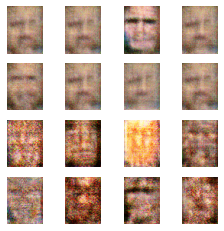

Epoch: 17,	 G Loss: 18.56944,	 D Loss: -13.70540,  D_Real_loss: 2.69484,  D_Fake_loss: -16.40024,	 G_fake_loss 18.56944,	 G_dist: 2.44055,	 G_pen: 0.00000


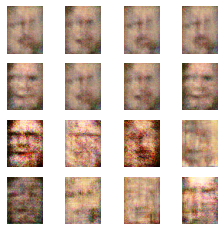

Epoch: 18,	 G Loss: 39.38004,	 D Loss: -13.37498,  D_Real_loss: 31.84950,  D_Fake_loss: -45.22448,	 G_fake_loss 39.38004,	 G_dist: 2.46071,	 G_pen: 0.00000


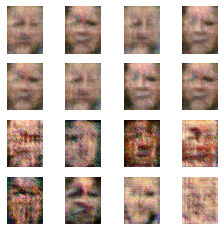

Epoch: 18,	 G Loss: 57.38856,	 D Loss: -21.53558,  D_Real_loss: 38.73188,  D_Fake_loss: -60.26746,	 G_fake_loss 57.38856,	 G_dist: 2.44317,	 G_pen: 0.00000


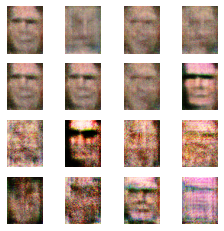

Epoch: 18,	 G Loss: 31.52571,	 D Loss: -13.68398,  D_Real_loss: 25.39186,  D_Fake_loss: -39.07584,	 G_fake_loss 31.52571,	 G_dist: 2.34709,	 G_pen: 0.00000


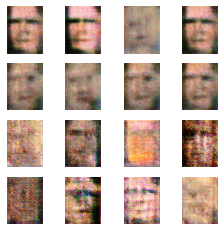

Epoch: 18,	 G Loss: 19.75011,	 D Loss: -10.42525,  D_Real_loss: 6.34727,  D_Fake_loss: -16.77253,	 G_fake_loss 19.75011,	 G_dist: 2.49851,	 G_pen: 0.00000


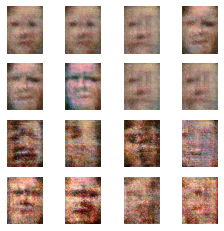

Epoch: 19,	 G Loss: 24.52744,	 D Loss: -10.13206,  D_Real_loss: 13.42124,  D_Fake_loss: -23.55330,	 G_fake_loss 24.52744,	 G_dist: 2.48325,	 G_pen: 0.00000


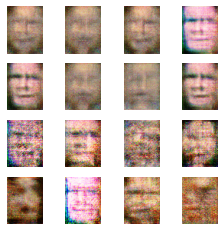

Epoch: 19,	 G Loss: 21.45653,	 D Loss: -19.78037,  D_Real_loss: 6.13224,  D_Fake_loss: -25.91261,	 G_fake_loss 21.45653,	 G_dist: 2.45757,	 G_pen: 0.00000


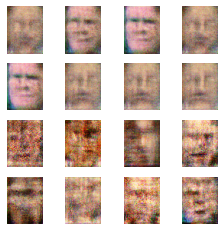

Epoch: 19,	 G Loss: -0.09822,	 D Loss: -18.93477,  D_Real_loss: -23.81120,  D_Fake_loss: 4.87643,	 G_fake_loss -0.11287,	 G_dist: 2.45830,	 G_pen: 0.01466


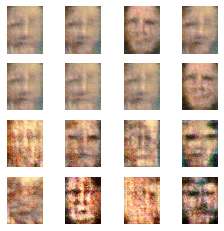

Epoch: 19,	 G Loss: 36.30280,	 D Loss: -10.21890,  D_Real_loss: 25.48627,  D_Fake_loss: -35.70517,	 G_fake_loss 36.30280,	 G_dist: 2.46201,	 G_pen: 0.00000


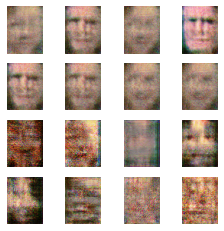

Epoch: 19,	 Generator Loss: 29.001516342163086,	 Discriminator Loss: -10.310157775878906
Total time to epoch 20 is 26.410720721880594 min
Epoch: 20,	 G Loss: 65.61949,	 D Loss: -12.20949,  D_Real_loss: 47.74507,  D_Fake_loss: -59.95456,	 G_fake_loss 65.61949,	 G_dist: 2.41563,	 G_pen: 0.00000


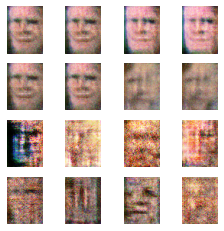

Epoch: 20,	 G Loss: 60.80310,	 D Loss: -9.17536,  D_Real_loss: 48.02708,  D_Fake_loss: -57.20245,	 G_fake_loss 60.80310,	 G_dist: 2.41068,	 G_pen: 0.00000


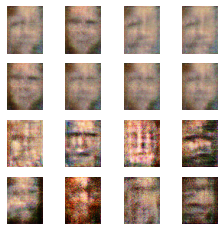

Epoch: 20,	 G Loss: 1.72446,	 D Loss: -14.09030,  D_Real_loss: -13.13941,  D_Fake_loss: -0.95090,	 G_fake_loss 1.65948,	 G_dist: 2.44985,	 G_pen: 0.06498


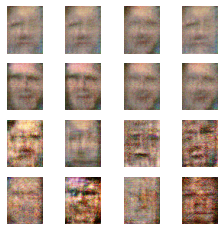

Epoch: 20,	 G Loss: 37.34197,	 D Loss: -12.64048,  D_Real_loss: 30.36272,  D_Fake_loss: -43.00320,	 G_fake_loss 37.34197,	 G_dist: 2.44154,	 G_pen: 0.00000


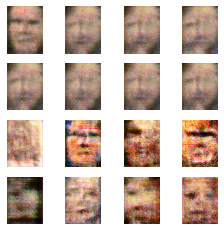

Epoch: 21,	 G Loss: 38.57709,	 D Loss: -9.97701,  D_Real_loss: 25.71786,  D_Fake_loss: -35.69487,	 G_fake_loss 38.57709,	 G_dist: 2.44927,	 G_pen: 0.00000


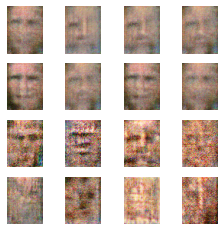

Epoch: 21,	 G Loss: 29.92785,	 D Loss: -12.20025,  D_Real_loss: 19.06213,  D_Fake_loss: -31.26239,	 G_fake_loss 29.92785,	 G_dist: 2.41242,	 G_pen: 0.00000


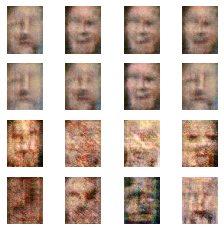

Epoch: 21,	 G Loss: 14.39656,	 D Loss: -9.99861,  D_Real_loss: 1.71835,  D_Fake_loss: -11.71696,	 G_fake_loss 14.39656,	 G_dist: 2.46353,	 G_pen: 0.00000


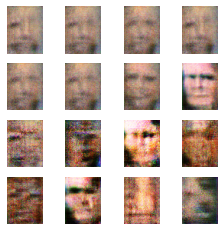

Epoch: 21,	 G Loss: 47.92664,	 D Loss: -12.41607,  D_Real_loss: 41.88667,  D_Fake_loss: -54.30274,	 G_fake_loss 47.92664,	 G_dist: 2.50811,	 G_pen: 0.00000


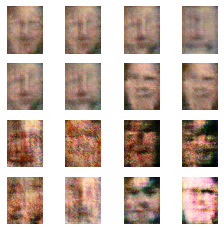

Epoch: 22,	 G Loss: 13.26219,	 D Loss: -10.46637,  D_Real_loss: 6.23582,  D_Fake_loss: -16.70218,	 G_fake_loss 13.26218,	 G_dist: 2.42659,	 G_pen: 0.00001


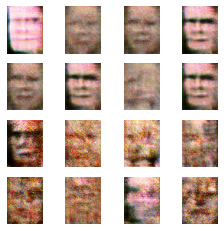

Epoch: 22,	 G Loss: 18.30048,	 D Loss: -8.83113,  D_Real_loss: 6.43837,  D_Fake_loss: -15.26950,	 G_fake_loss 18.30048,	 G_dist: 2.41065,	 G_pen: 0.00000


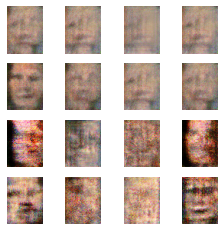

Epoch: 22,	 G Loss: 84.47592,	 D Loss: -14.22943,  D_Real_loss: 65.87337,  D_Fake_loss: -80.10280,	 G_fake_loss 84.47592,	 G_dist: 2.42968,	 G_pen: 0.00000


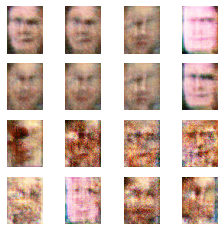

Epoch: 22,	 G Loss: 19.01607,	 D Loss: -15.06982,  D_Real_loss: 4.03049,  D_Fake_loss: -19.10031,	 G_fake_loss 19.01607,	 G_dist: 2.50692,	 G_pen: 0.00000


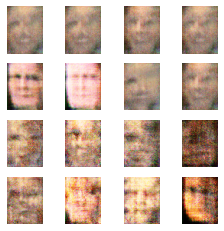

Epoch: 23,	 G Loss: 8.47842,	 D Loss: -8.97149,  D_Real_loss: -0.90693,  D_Fake_loss: -8.06456,	 G_fake_loss 8.47799,	 G_dist: 2.42841,	 G_pen: 0.00043


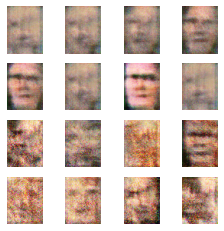

Epoch: 23,	 G Loss: 11.80592,	 D Loss: -14.01554,  D_Real_loss: -4.28384,  D_Fake_loss: -9.73170,	 G_fake_loss 11.80589,	 G_dist: 2.42301,	 G_pen: 0.00002


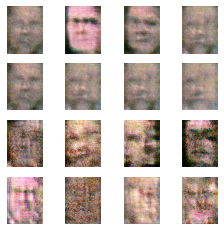

Epoch: 23,	 G Loss: 22.73235,	 D Loss: -12.88580,  D_Real_loss: 7.75895,  D_Fake_loss: -20.64475,	 G_fake_loss 22.73235,	 G_dist: 2.51220,	 G_pen: 0.00000


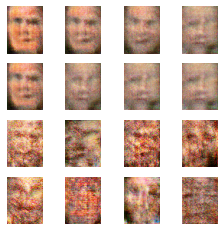

Epoch: 23,	 G Loss: -3.11970,	 D Loss: -11.10887,  D_Real_loss: -14.01820,  D_Fake_loss: 2.90933,	 G_fake_loss -4.15548,	 G_dist: 2.53163,	 G_pen: 1.03577


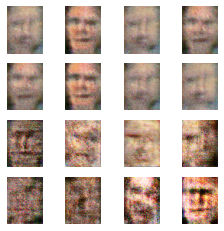

Epoch: 24,	 G Loss: 36.50671,	 D Loss: -10.41677,  D_Real_loss: 23.84545,  D_Fake_loss: -34.26221,	 G_fake_loss 36.50671,	 G_dist: 2.46004,	 G_pen: 0.00000


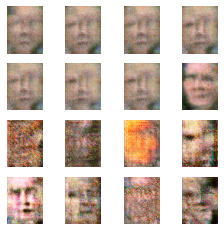

Epoch: 24,	 G Loss: -2.40158,	 D Loss: -16.33074,  D_Real_loss: -19.60846,  D_Fake_loss: 3.27772,	 G_fake_loss -3.18746,	 G_dist: 2.56733,	 G_pen: 0.78589


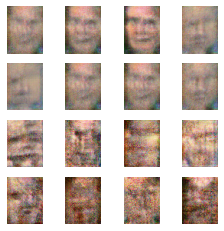

Epoch: 24,	 G Loss: 40.41742,	 D Loss: -11.05411,  D_Real_loss: 29.04386,  D_Fake_loss: -40.09797,	 G_fake_loss 40.41742,	 G_dist: 2.47846,	 G_pen: 0.00000


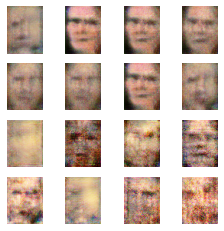

Epoch: 24,	 G Loss: 0.51033,	 D Loss: -15.60288,  D_Real_loss: -14.68080,  D_Fake_loss: -0.92208,	 G_fake_loss 0.46674,	 G_dist: 2.42343,	 G_pen: 0.04359


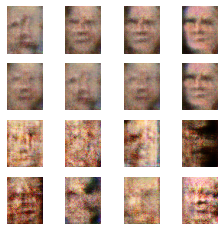

Epoch: 25,	 G Loss: -5.78537,	 D Loss: -8.01938,  D_Real_loss: -13.52557,  D_Fake_loss: 5.50619,	 G_fake_loss -7.63556,	 G_dist: 2.42429,	 G_pen: 1.85019


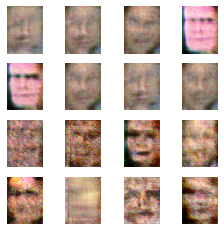

Epoch: 25,	 G Loss: 10.30393,	 D Loss: -8.66421,  D_Real_loss: 0.82712,  D_Fake_loss: -9.49133,	 G_fake_loss 10.30385,	 G_dist: 2.43642,	 G_pen: 0.00008


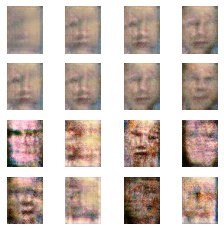

Epoch: 25,	 G Loss: 43.49231,	 D Loss: -11.95495,  D_Real_loss: 33.15760,  D_Fake_loss: -45.11255,	 G_fake_loss 43.49231,	 G_dist: 2.44988,	 G_pen: 0.00000


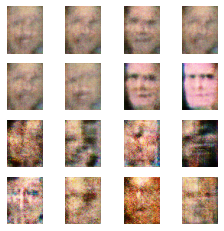

Epoch: 25,	 G Loss: 31.66315,	 D Loss: -9.39304,  D_Real_loss: 18.02155,  D_Fake_loss: -27.41459,	 G_fake_loss 31.66315,	 G_dist: 2.52498,	 G_pen: 0.00000


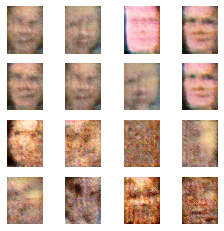

Epoch: 26,	 G Loss: 14.94469,	 D Loss: -8.90238,  D_Real_loss: 5.46132,  D_Fake_loss: -14.36370,	 G_fake_loss 14.94469,	 G_dist: 2.47175,	 G_pen: 0.00000


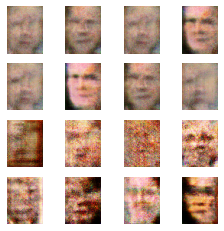

Epoch: 26,	 G Loss: 19.71333,	 D Loss: -8.26957,  D_Real_loss: 8.48011,  D_Fake_loss: -16.74968,	 G_fake_loss 19.71333,	 G_dist: 2.43047,	 G_pen: 0.00000


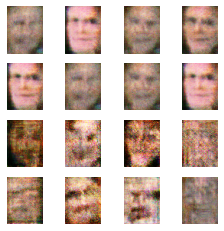

Epoch: 26,	 G Loss: 41.65874,	 D Loss: -16.34542,  D_Real_loss: 28.51478,  D_Fake_loss: -44.86020,	 G_fake_loss 41.65874,	 G_dist: 2.44205,	 G_pen: 0.00000


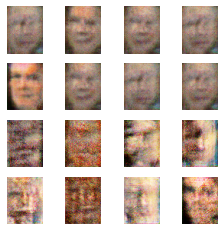

Epoch: 26,	 G Loss: 13.31224,	 D Loss: -5.94135,  D_Real_loss: 6.39918,  D_Fake_loss: -12.34053,	 G_fake_loss 13.31224,	 G_dist: 2.50929,	 G_pen: 0.00001


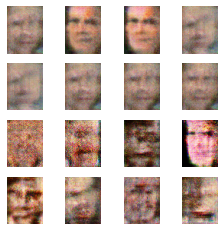

Epoch: 27,	 G Loss: 11.59747,	 D Loss: -12.70586,  D_Real_loss: -0.18445,  D_Fake_loss: -12.52141,	 G_fake_loss 11.59744,	 G_dist: 2.43400,	 G_pen: 0.00003


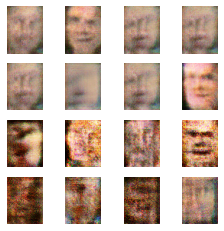

Epoch: 27,	 G Loss: 20.72970,	 D Loss: -10.02950,  D_Real_loss: 7.95422,  D_Fake_loss: -17.98372,	 G_fake_loss 20.72970,	 G_dist: 2.45007,	 G_pen: 0.00000


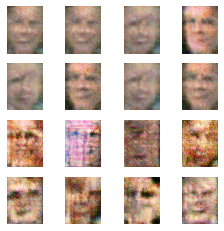

Epoch: 27,	 G Loss: 14.65785,	 D Loss: -10.60832,  D_Real_loss: 2.71829,  D_Fake_loss: -13.32661,	 G_fake_loss 14.65784,	 G_dist: 2.54686,	 G_pen: 0.00000


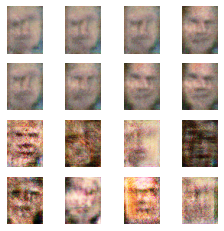

Epoch: 27,	 G Loss: 46.49296,	 D Loss: -14.64600,  D_Real_loss: 33.74703,  D_Fake_loss: -48.39304,	 G_fake_loss 46.49296,	 G_dist: 2.50978,	 G_pen: 0.00000


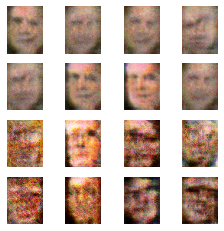

Epoch: 28,	 G Loss: 37.86176,	 D Loss: -17.56520,  D_Real_loss: 28.14993,  D_Fake_loss: -45.71513,	 G_fake_loss 37.86176,	 G_dist: 2.48873,	 G_pen: 0.00000


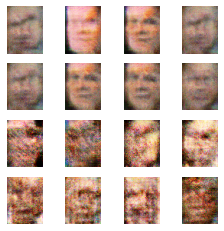

Epoch: 28,	 G Loss: -2.17340,	 D Loss: -10.35133,  D_Real_loss: -12.77175,  D_Fake_loss: 2.42042,	 G_fake_loss -2.86396,	 G_dist: 2.54874,	 G_pen: 0.69056


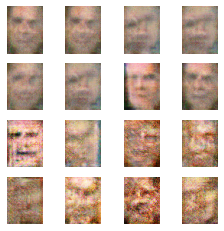

Epoch: 28,	 G Loss: 19.22239,	 D Loss: -12.00296,  D_Real_loss: 8.89059,  D_Fake_loss: -20.89355,	 G_fake_loss 19.22239,	 G_dist: 2.56159,	 G_pen: 0.00000


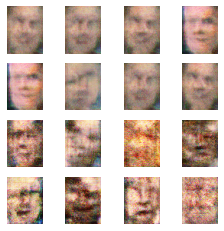

Epoch: 28,	 G Loss: 36.90405,	 D Loss: -11.27565,  D_Real_loss: 22.92212,  D_Fake_loss: -34.19777,	 G_fake_loss 36.90405,	 G_dist: 2.49434,	 G_pen: 0.00000


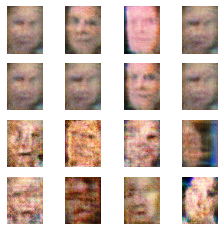

Epoch: 29,	 G Loss: -18.05753,	 D Loss: -10.28399,  D_Real_loss: -34.31499,  D_Fake_loss: 24.03101,	 G_fake_loss -24.03027,	 G_dist: 2.48551,	 G_pen: 5.97274


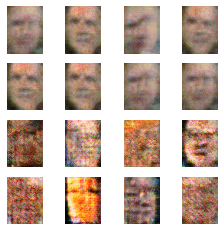

Epoch: 29,	 G Loss: 12.18740,	 D Loss: -9.40975,  D_Real_loss: 4.12651,  D_Fake_loss: -13.53626,	 G_fake_loss 12.18739,	 G_dist: 2.42786,	 G_pen: 0.00002


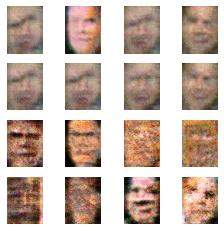

Epoch: 29,	 G Loss: 7.40640,	 D Loss: -9.39508,  D_Real_loss: -1.23052,  D_Fake_loss: -8.16456,	 G_fake_loss 7.40527,	 G_dist: 2.50705,	 G_pen: 0.00113


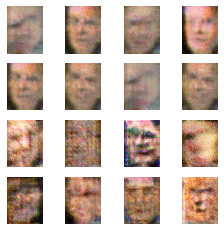

Epoch: 29,	 G Loss: 8.97898,	 D Loss: -10.39766,  D_Real_loss: 0.62645,  D_Fake_loss: -11.02411,	 G_fake_loss 8.97870,	 G_dist: 2.47506,	 G_pen: 0.00028


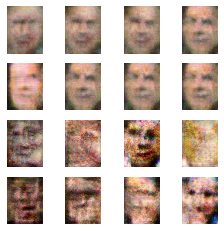

Epoch: 29,	 Generator Loss: 12.023154258728027,	 Discriminator Loss: -8.557439804077148
Total time to epoch 30 is 39.52834343115489 min
Epoch: 30,	 G Loss: 17.37665,	 D Loss: -8.39851,  D_Real_loss: 6.35378,  D_Fake_loss: -14.75229,	 G_fake_loss 17.37665,	 G_dist: 2.56947,	 G_pen: 0.00000


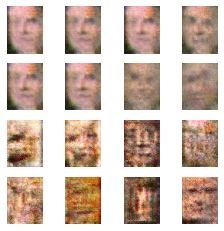

Epoch: 30,	 G Loss: 33.04945,	 D Loss: -11.46230,  D_Real_loss: 19.39798,  D_Fake_loss: -30.86028,	 G_fake_loss 33.04945,	 G_dist: 2.53969,	 G_pen: 0.00000


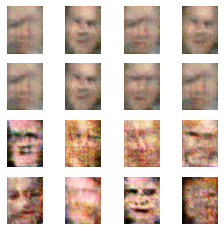

Epoch: 30,	 G Loss: 38.61055,	 D Loss: -7.78988,  D_Real_loss: 29.54032,  D_Fake_loss: -37.33020,	 G_fake_loss 38.61055,	 G_dist: 2.44871,	 G_pen: 0.00000


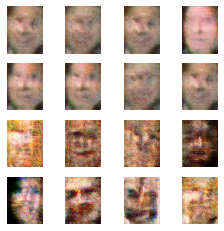

Epoch: 30,	 G Loss: 47.95816,	 D Loss: -9.29964,  D_Real_loss: 37.94968,  D_Fake_loss: -47.24932,	 G_fake_loss 47.95816,	 G_dist: 2.57256,	 G_pen: 0.00000


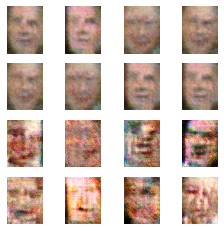

Epoch: 31,	 G Loss: 27.55089,	 D Loss: -8.99121,  D_Real_loss: 18.91108,  D_Fake_loss: -27.90230,	 G_fake_loss 27.55089,	 G_dist: 2.46792,	 G_pen: 0.00000


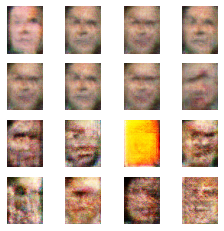

Epoch: 31,	 G Loss: 10.16789,	 D Loss: -10.84107,  D_Real_loss: -1.43962,  D_Fake_loss: -9.40145,	 G_fake_loss 10.16780,	 G_dist: 2.44816,	 G_pen: 0.00010


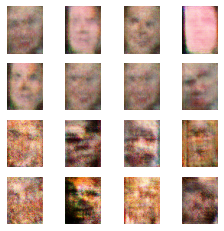

Epoch: 31,	 G Loss: -10.24258,	 D Loss: -10.52330,  D_Real_loss: -22.97413,  D_Fake_loss: 12.45082,	 G_fake_loss -13.71324,	 G_dist: 2.53088,	 G_pen: 3.47066


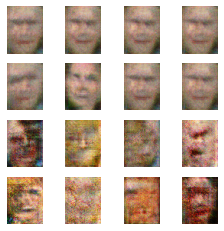

Epoch: 31,	 G Loss: 6.80786,	 D Loss: -8.28375,  D_Real_loss: -1.52374,  D_Fake_loss: -6.76001,	 G_fake_loss 6.80601,	 G_dist: 2.46149,	 G_pen: 0.00185


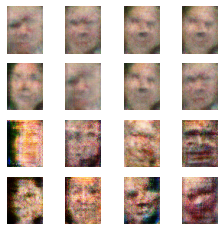

Epoch: 32,	 G Loss: 22.62739,	 D Loss: -9.96587,  D_Real_loss: 10.75830,  D_Fake_loss: -20.72417,	 G_fake_loss 22.62739,	 G_dist: 2.56110,	 G_pen: 0.00000


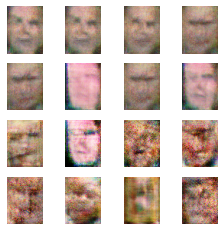

Epoch: 32,	 G Loss: -15.62729,	 D Loss: -14.51459,  D_Real_loss: -34.18060,  D_Fake_loss: 19.66601,	 G_fake_loss -20.88097,	 G_dist: 2.51601,	 G_pen: 5.25368


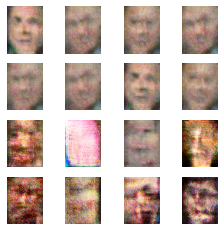

Epoch: 32,	 G Loss: -6.33357,	 D Loss: -11.08991,  D_Real_loss: -25.07741,  D_Fake_loss: 13.98750,	 G_fake_loss -8.35436,	 G_dist: 2.41942,	 G_pen: 2.02079


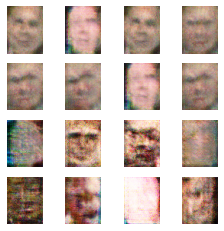

Epoch: 32,	 G Loss: -6.99810,	 D Loss: -11.12019,  D_Real_loss: -19.02675,  D_Fake_loss: 7.90656,	 G_fake_loss -9.33100,	 G_dist: 2.50039,	 G_pen: 2.33290


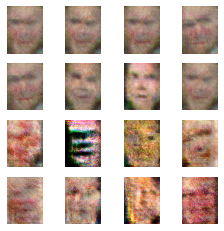

Epoch: 33,	 G Loss: 8.57121,	 D Loss: -9.12637,  D_Real_loss: 2.17239,  D_Fake_loss: -11.29876,	 G_fake_loss 8.57081,	 G_dist: 2.45632,	 G_pen: 0.00040


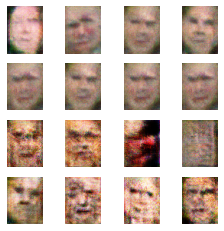

Epoch: 33,	 G Loss: 22.91207,	 D Loss: -10.63000,  D_Real_loss: 12.29341,  D_Fake_loss: -22.92341,	 G_fake_loss 22.91207,	 G_dist: 2.50328,	 G_pen: 0.00000


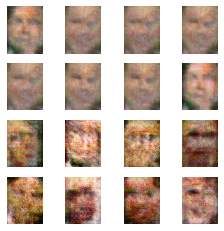

Epoch: 33,	 G Loss: 16.22206,	 D Loss: -10.92427,  D_Real_loss: 5.93450,  D_Fake_loss: -16.85876,	 G_fake_loss 16.22206,	 G_dist: 2.52318,	 G_pen: 0.00000


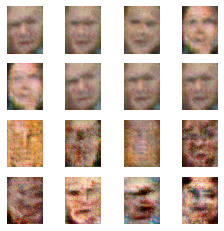

Epoch: 33,	 G Loss: -0.72320,	 D Loss: -10.58385,  D_Real_loss: -11.10109,  D_Fake_loss: 0.51723,	 G_fake_loss -0.87930,	 G_dist: 2.51217,	 G_pen: 0.15610


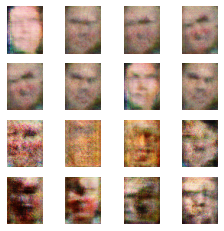

Epoch: 34,	 G Loss: -2.96901,	 D Loss: -10.51250,  D_Real_loss: -14.36976,  D_Fake_loss: 3.85726,	 G_fake_loss -3.97882,	 G_dist: 2.58545,	 G_pen: 1.00982


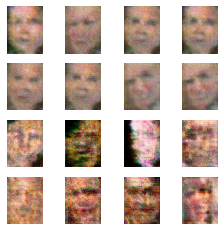

Epoch: 34,	 G Loss: 10.30274,	 D Loss: -9.30555,  D_Real_loss: 0.05958,  D_Fake_loss: -9.36513,	 G_fake_loss 10.30265,	 G_dist: 2.51941,	 G_pen: 0.00009


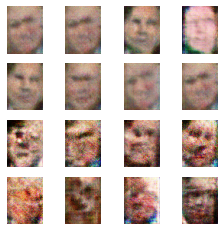

Epoch: 34,	 G Loss: -6.84648,	 D Loss: -10.63186,  D_Real_loss: -22.59163,  D_Fake_loss: 11.95977,	 G_fake_loss -9.20812,	 G_dist: 2.56500,	 G_pen: 2.36165


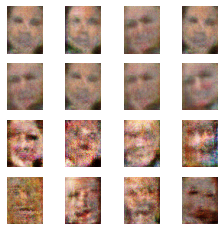

Epoch: 34,	 G Loss: -13.22747,	 D Loss: -8.34568,  D_Real_loss: -24.53808,  D_Fake_loss: 16.19240,	 G_fake_loss -17.60180,	 G_dist: 2.48516,	 G_pen: 4.37433


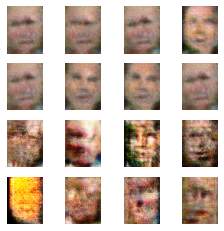

Epoch: 35,	 G Loss: -2.29901,	 D Loss: -6.61454,  D_Real_loss: -11.50369,  D_Fake_loss: 4.88914,	 G_fake_loss -3.01118,	 G_dist: 2.48152,	 G_pen: 0.71217


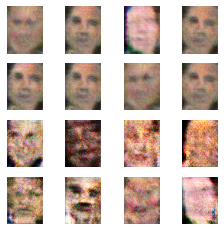

Epoch: 35,	 G Loss: -1.22954,	 D Loss: -9.77055,  D_Real_loss: -12.62955,  D_Fake_loss: 2.85900,	 G_fake_loss -1.54943,	 G_dist: 2.50302,	 G_pen: 0.31989


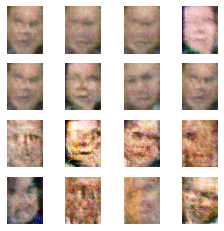

Epoch: 35,	 G Loss: -8.22454,	 D Loss: -11.50191,  D_Real_loss: -23.85976,  D_Fake_loss: 12.35785,	 G_fake_loss -10.97342,	 G_dist: 2.50508,	 G_pen: 2.74888


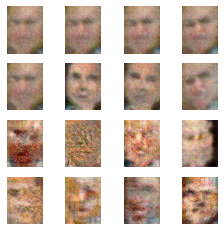

Epoch: 35,	 G Loss: 23.54550,	 D Loss: -8.47700,  D_Real_loss: 14.64369,  D_Fake_loss: -23.12069,	 G_fake_loss 23.54550,	 G_dist: 2.45876,	 G_pen: 0.00000


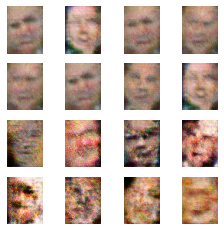

Epoch: 36,	 G Loss: 26.28797,	 D Loss: -6.63430,  D_Real_loss: 17.12666,  D_Fake_loss: -23.76096,	 G_fake_loss 26.28797,	 G_dist: 2.55217,	 G_pen: 0.00000


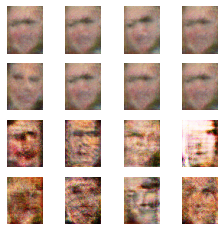

Epoch: 36,	 G Loss: 34.32926,	 D Loss: -9.35812,  D_Real_loss: 23.20547,  D_Fake_loss: -32.56359,	 G_fake_loss 34.32926,	 G_dist: 2.49212,	 G_pen: 0.00000


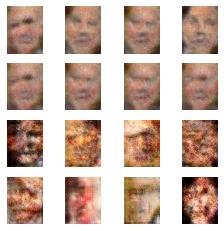

Epoch: 36,	 G Loss: 8.32968,	 D Loss: -9.16524,  D_Real_loss: 1.05117,  D_Fake_loss: -10.21641,	 G_fake_loss 8.32917,	 G_dist: 2.53588,	 G_pen: 0.00051


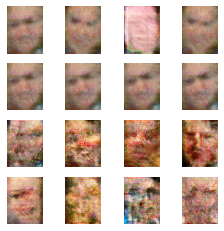

Epoch: 36,	 G Loss: 8.10740,	 D Loss: -13.35235,  D_Real_loss: -2.08940,  D_Fake_loss: -11.26295,	 G_fake_loss 8.10677,	 G_dist: 2.57868,	 G_pen: 0.00063


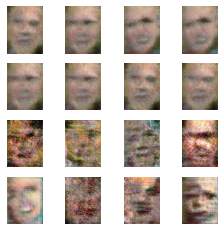

Epoch: 37,	 G Loss: 14.87173,	 D Loss: -11.37900,  D_Real_loss: 4.57917,  D_Fake_loss: -15.95817,	 G_fake_loss 14.87173,	 G_dist: 2.57765,	 G_pen: 0.00000


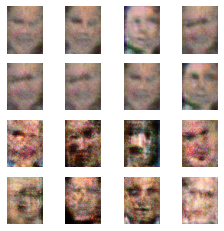

Epoch: 37,	 G Loss: 44.33893,	 D Loss: -10.97083,  D_Real_loss: 33.85526,  D_Fake_loss: -44.82609,	 G_fake_loss 44.33893,	 G_dist: 2.55081,	 G_pen: 0.00000


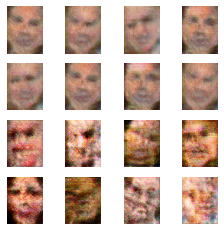

Epoch: 37,	 G Loss: 39.86039,	 D Loss: -9.60352,  D_Real_loss: 30.55856,  D_Fake_loss: -40.16208,	 G_fake_loss 39.86039,	 G_dist: 2.54818,	 G_pen: 0.00000


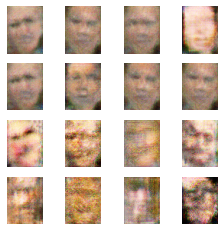

Epoch: 37,	 G Loss: 30.43751,	 D Loss: -9.56146,  D_Real_loss: 20.33937,  D_Fake_loss: -29.90083,	 G_fake_loss 30.43751,	 G_dist: 2.56095,	 G_pen: 0.00000


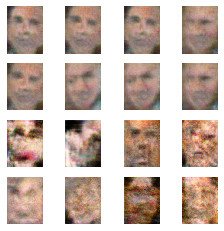

Epoch: 38,	 G Loss: 27.49807,	 D Loss: -10.75453,  D_Real_loss: 13.35218,  D_Fake_loss: -24.10671,	 G_fake_loss 27.49807,	 G_dist: 2.56294,	 G_pen: 0.00000


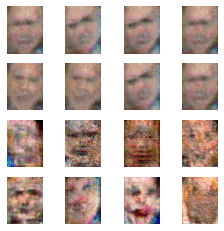

Epoch: 38,	 G Loss: 19.21720,	 D Loss: -11.59381,  D_Real_loss: 6.71914,  D_Fake_loss: -18.31295,	 G_fake_loss 19.21720,	 G_dist: 2.55248,	 G_pen: 0.00000


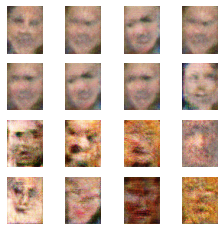

Epoch: 38,	 G Loss: 37.01183,	 D Loss: -7.77746,  D_Real_loss: 29.27483,  D_Fake_loss: -37.05229,	 G_fake_loss 37.01183,	 G_dist: 2.53254,	 G_pen: 0.00000


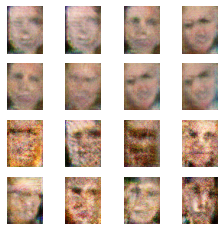

Epoch: 38,	 G Loss: 53.93235,	 D Loss: -10.22934,  D_Real_loss: 40.58432,  D_Fake_loss: -50.81367,	 G_fake_loss 53.93235,	 G_dist: 2.55453,	 G_pen: 0.00000


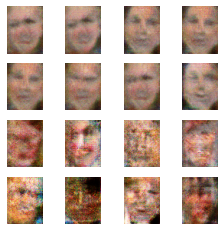

Epoch: 39,	 G Loss: -12.79643,	 D Loss: -8.77537,  D_Real_loss: -24.80895,  D_Fake_loss: 16.03357,	 G_fake_loss -17.15022,	 G_dist: 2.53862,	 G_pen: 4.35379


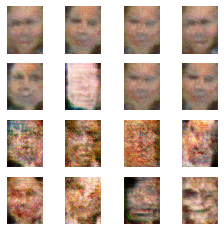

Epoch: 39,	 G Loss: 18.98780,	 D Loss: -9.15295,  D_Real_loss: 9.09171,  D_Fake_loss: -18.24467,	 G_fake_loss 18.98780,	 G_dist: 2.53414,	 G_pen: 0.00000


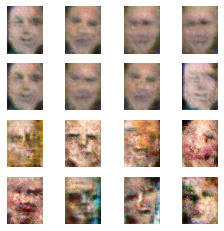

Epoch: 39,	 G Loss: 23.15444,	 D Loss: -10.55465,  D_Real_loss: 12.21223,  D_Fake_loss: -22.76688,	 G_fake_loss 23.15444,	 G_dist: 2.55273,	 G_pen: 0.00000


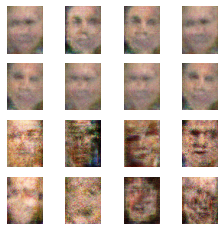

Epoch: 39,	 G Loss: 30.61913,	 D Loss: -11.33647,  D_Real_loss: 19.84434,  D_Fake_loss: -31.18081,	 G_fake_loss 30.61913,	 G_dist: 2.51622,	 G_pen: 0.00000


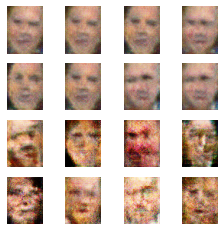

Epoch: 39,	 Generator Loss: 29.326372146606445,	 Discriminator Loss: -12.757732391357422
Total time to epoch 40 is 52.65677005847295 min
Epoch: 40,	 G Loss: 30.81876,	 D Loss: -8.31783,  D_Real_loss: 23.01147,  D_Fake_loss: -31.32929,	 G_fake_loss 30.81876,	 G_dist: 2.55957,	 G_pen: 0.00000


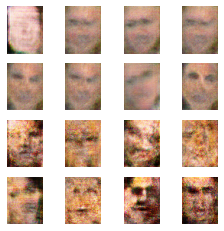

Epoch: 40,	 G Loss: 25.77668,	 D Loss: -7.12943,  D_Real_loss: 17.96803,  D_Fake_loss: -25.09746,	 G_fake_loss 25.77668,	 G_dist: 2.58055,	 G_pen: 0.00000


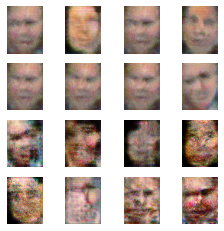

Epoch: 40,	 G Loss: 12.66982,	 D Loss: -5.22167,  D_Real_loss: 6.29959,  D_Fake_loss: -11.52127,	 G_fake_loss 12.66981,	 G_dist: 2.55328,	 G_pen: 0.00001


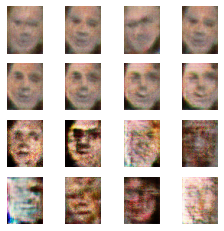

Epoch: 40,	 G Loss: 31.71816,	 D Loss: -7.51952,  D_Real_loss: 25.42281,  D_Fake_loss: -32.94233,	 G_fake_loss 31.71816,	 G_dist: 2.49525,	 G_pen: 0.00000


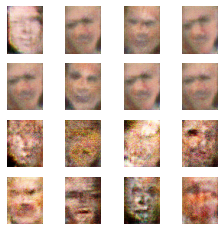

Epoch: 41,	 G Loss: 35.88500,	 D Loss: -10.99084,  D_Real_loss: 23.32997,  D_Fake_loss: -34.32081,	 G_fake_loss 35.88500,	 G_dist: 2.55892,	 G_pen: 0.00000


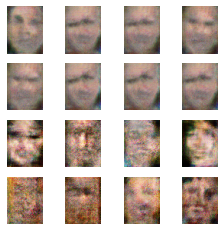

Epoch: 41,	 G Loss: 34.67319,	 D Loss: -7.30265,  D_Real_loss: 26.26914,  D_Fake_loss: -33.57180,	 G_fake_loss 34.67319,	 G_dist: 2.48757,	 G_pen: 0.00000


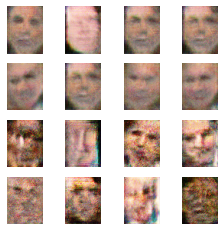

Epoch: 41,	 G Loss: 9.43739,	 D Loss: -7.38648,  D_Real_loss: 3.08366,  D_Fake_loss: -10.47014,	 G_fake_loss 9.43720,	 G_dist: 2.50904,	 G_pen: 0.00019


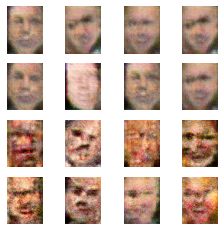

Epoch: 41,	 G Loss: 6.57826,	 D Loss: -9.28153,  D_Real_loss: -2.15124,  D_Fake_loss: -7.13030,	 G_fake_loss 6.57592,	 G_dist: 2.55715,	 G_pen: 0.00234


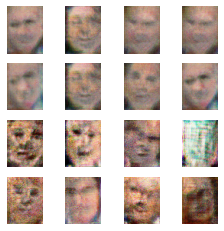

Epoch: 42,	 G Loss: 8.52700,	 D Loss: -8.71599,  D_Real_loss: -2.18589,  D_Fake_loss: -6.53010,	 G_fake_loss 8.52658,	 G_dist: 2.51556,	 G_pen: 0.00042


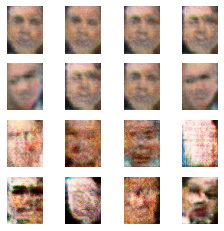

Epoch: 42,	 G Loss: -11.97345,	 D Loss: -12.65060,  D_Real_loss: -29.85620,  D_Fake_loss: 17.20560,	 G_fake_loss -16.09437,	 G_dist: 2.56048,	 G_pen: 4.12093


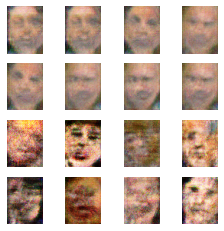

Epoch: 42,	 G Loss: 1.26559,	 D Loss: -7.27252,  D_Real_loss: -5.60659,  D_Fake_loss: -1.66592,	 G_fake_loss 1.19516,	 G_dist: 2.53660,	 G_pen: 0.07044


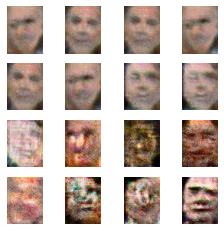

Epoch: 42,	 G Loss: 39.18728,	 D Loss: -9.12714,  D_Real_loss: 29.31580,  D_Fake_loss: -38.44293,	 G_fake_loss 39.18728,	 G_dist: 2.54118,	 G_pen: 0.00000


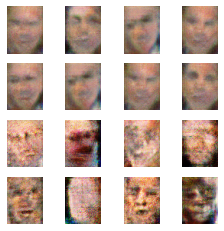

Epoch: 43,	 G Loss: 30.73321,	 D Loss: -9.22245,  D_Real_loss: 23.08969,  D_Fake_loss: -32.31215,	 G_fake_loss 30.73321,	 G_dist: 2.51844,	 G_pen: 0.00000


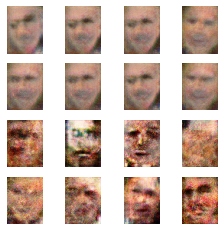

Epoch: 43,	 G Loss: 17.34597,	 D Loss: -6.55814,  D_Real_loss: 9.21947,  D_Fake_loss: -15.77761,	 G_fake_loss 17.34597,	 G_dist: 2.56841,	 G_pen: 0.00000


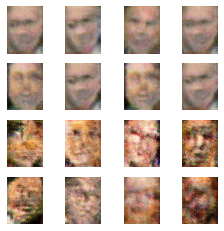

Epoch: 43,	 G Loss: 8.12336,	 D Loss: -6.87419,  D_Real_loss: 0.71588,  D_Fake_loss: -7.59006,	 G_fake_loss 8.12274,	 G_dist: 2.55698,	 G_pen: 0.00062


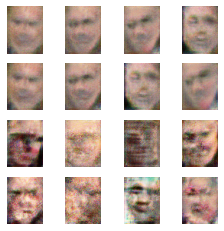

Epoch: 43,	 G Loss: 21.59032,	 D Loss: -11.15488,  D_Real_loss: 10.35578,  D_Fake_loss: -21.51066,	 G_fake_loss 21.59032,	 G_dist: 2.55093,	 G_pen: 0.00000


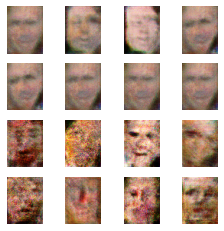

Epoch: 44,	 G Loss: 39.69866,	 D Loss: -8.26445,  D_Real_loss: 32.85545,  D_Fake_loss: -41.11990,	 G_fake_loss 39.69866,	 G_dist: 2.54991,	 G_pen: 0.00000


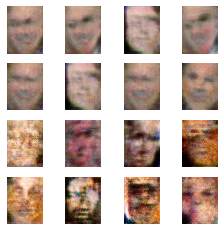

Epoch: 44,	 G Loss: 15.44297,	 D Loss: -10.04600,  D_Real_loss: 6.34074,  D_Fake_loss: -16.38673,	 G_fake_loss 15.44297,	 G_dist: 2.54578,	 G_pen: 0.00000


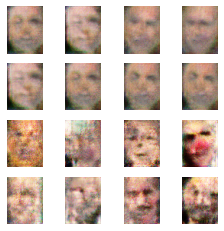

Epoch: 44,	 G Loss: 10.93002,	 D Loss: -8.19350,  D_Real_loss: 2.28663,  D_Fake_loss: -10.48013,	 G_fake_loss 10.92997,	 G_dist: 2.58890,	 G_pen: 0.00005


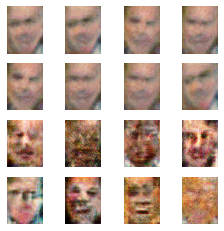

Epoch: 44,	 G Loss: 13.73669,	 D Loss: -10.85869,  D_Real_loss: 2.74919,  D_Fake_loss: -13.60788,	 G_fake_loss 13.73669,	 G_dist: 2.58333,	 G_pen: 0.00000


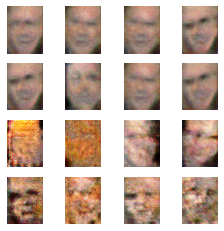

Epoch: 45,	 G Loss: 15.89228,	 D Loss: -8.55341,  D_Real_loss: 8.76172,  D_Fake_loss: -17.31513,	 G_fake_loss 15.89228,	 G_dist: 2.54805,	 G_pen: 0.00000


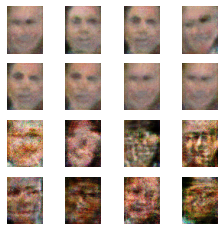

Epoch: 45,	 G Loss: 40.74265,	 D Loss: -8.20377,  D_Real_loss: 32.98578,  D_Fake_loss: -41.18954,	 G_fake_loss 40.74265,	 G_dist: 2.57730,	 G_pen: 0.00000


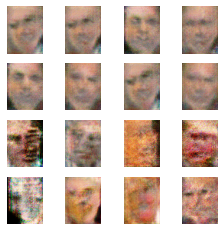

Epoch: 45,	 G Loss: 31.35180,	 D Loss: -7.65901,  D_Real_loss: 21.97122,  D_Fake_loss: -29.63023,	 G_fake_loss 31.35180,	 G_dist: 2.55508,	 G_pen: 0.00000


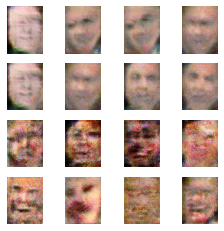

Epoch: 45,	 G Loss: -2.23848,	 D Loss: -12.64481,  D_Real_loss: -16.55139,  D_Fake_loss: 3.90658,	 G_fake_loss -2.96826,	 G_dist: 2.58495,	 G_pen: 0.72978


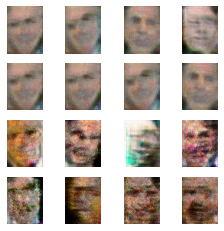

Epoch: 46,	 G Loss: 41.34213,	 D Loss: -8.65780,  D_Real_loss: 32.21008,  D_Fake_loss: -40.86788,	 G_fake_loss 41.34213,	 G_dist: 2.48492,	 G_pen: 0.00000


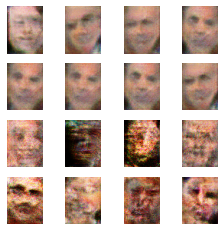

Epoch: 46,	 G Loss: 7.51956,	 D Loss: -6.87758,  D_Real_loss: -0.92446,  D_Fake_loss: -5.95312,	 G_fake_loss 7.51851,	 G_dist: 2.56874,	 G_pen: 0.00105


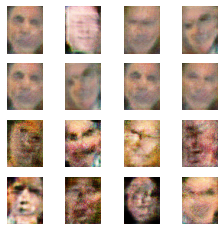

Epoch: 46,	 G Loss: 24.00049,	 D Loss: -9.82235,  D_Real_loss: 13.42726,  D_Fake_loss: -23.24961,	 G_fake_loss 24.00049,	 G_dist: 2.60999,	 G_pen: 0.00000


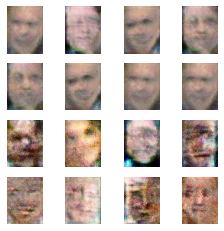

Epoch: 46,	 G Loss: 23.87483,	 D Loss: -8.80084,  D_Real_loss: 14.69121,  D_Fake_loss: -23.49205,	 G_fake_loss 23.87483,	 G_dist: 2.55540,	 G_pen: 0.00000


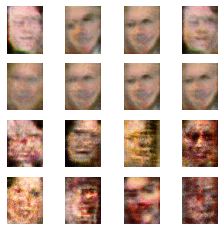

Epoch: 47,	 G Loss: -6.02118,	 D Loss: -11.68979,  D_Real_loss: -18.82448,  D_Fake_loss: 7.13468,	 G_fake_loss -8.12296,	 G_dist: 2.58823,	 G_pen: 2.10178


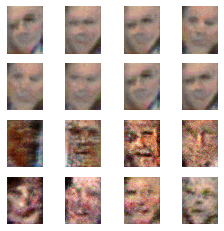

Epoch: 47,	 G Loss: 34.73387,	 D Loss: -7.11947,  D_Real_loss: 27.69464,  D_Fake_loss: -34.81411,	 G_fake_loss 34.73387,	 G_dist: 2.54506,	 G_pen: 0.00000


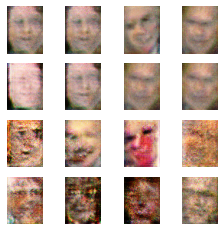

Epoch: 47,	 G Loss: -15.34344,	 D Loss: -11.78443,  D_Real_loss: -36.28413,  D_Fake_loss: 24.49970,	 G_fake_loss -20.57020,	 G_dist: 2.54093,	 G_pen: 5.22675


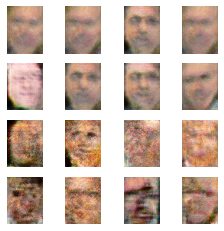

Epoch: 47,	 G Loss: -23.45495,	 D Loss: -9.59888,  D_Real_loss: -41.84856,  D_Fake_loss: 32.24968,	 G_fake_loss -31.16736,	 G_dist: 2.47452,	 G_pen: 7.71241


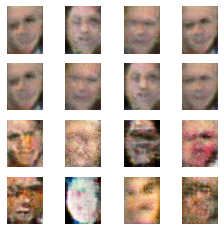

Epoch: 48,	 G Loss: 14.07885,	 D Loss: -10.45878,  D_Real_loss: 8.29854,  D_Fake_loss: -18.75732,	 G_fake_loss 14.07885,	 G_dist: 2.46431,	 G_pen: 0.00000


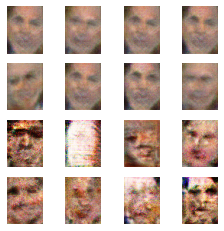

Epoch: 48,	 G Loss: 48.90748,	 D Loss: -10.18478,  D_Real_loss: 38.50970,  D_Fake_loss: -48.69448,	 G_fake_loss 48.90748,	 G_dist: 2.55534,	 G_pen: 0.00000


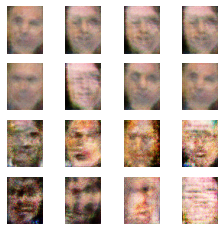

Epoch: 48,	 G Loss: 41.84113,	 D Loss: -9.37074,  D_Real_loss: 33.46994,  D_Fake_loss: -42.84067,	 G_fake_loss 41.84113,	 G_dist: 2.51397,	 G_pen: 0.00000


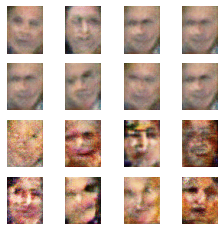

Epoch: 48,	 G Loss: 44.37663,	 D Loss: -8.91908,  D_Real_loss: 33.33398,  D_Fake_loss: -42.25307,	 G_fake_loss 44.37663,	 G_dist: 2.57140,	 G_pen: 0.00000


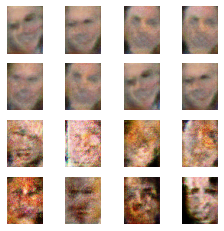

Epoch: 49,	 G Loss: 17.33757,	 D Loss: -8.44349,  D_Real_loss: 10.45236,  D_Fake_loss: -18.89585,	 G_fake_loss 17.33757,	 G_dist: 2.57891,	 G_pen: 0.00000


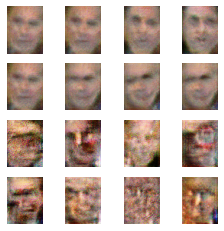

Epoch: 49,	 G Loss: 18.21283,	 D Loss: -14.50276,  D_Real_loss: 1.11354,  D_Fake_loss: -15.61630,	 G_fake_loss 18.21283,	 G_dist: 2.54531,	 G_pen: 0.00000


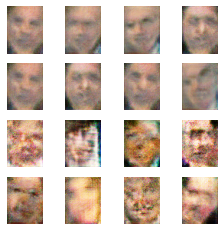

Epoch: 49,	 G Loss: 28.77760,	 D Loss: -10.10899,  D_Real_loss: 18.99751,  D_Fake_loss: -29.10651,	 G_fake_loss 28.77760,	 G_dist: 2.55107,	 G_pen: 0.00000


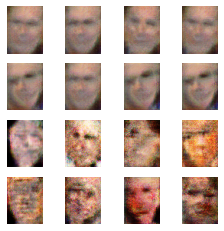

Epoch: 49,	 G Loss: 43.21204,	 D Loss: -7.49374,  D_Real_loss: 36.01412,  D_Fake_loss: -43.50786,	 G_fake_loss 43.21204,	 G_dist: 2.55665,	 G_pen: 0.00000


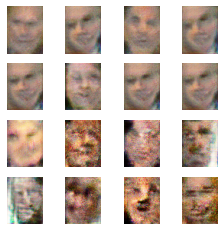

Epoch: 49,	 Generator Loss: 42.46138000488281,	 Discriminator Loss: -6.734424591064453
Total time to epoch 50 is 65.77422298987706 min
Epoch: 50,	 G Loss: 42.68259,	 D Loss: -14.77675,  D_Real_loss: 26.69630,  D_Fake_loss: -41.47305,	 G_fake_loss 42.68259,	 G_dist: 2.55708,	 G_pen: 0.00000


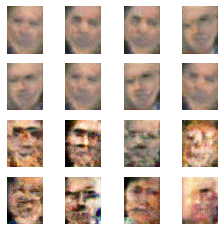

Epoch: 50,	 G Loss: 41.62301,	 D Loss: -7.52382,  D_Real_loss: 31.03808,  D_Fake_loss: -38.56190,	 G_fake_loss 41.62301,	 G_dist: 2.56127,	 G_pen: 0.00000


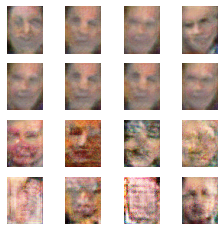

Epoch: 50,	 G Loss: 40.45903,	 D Loss: -7.28866,  D_Real_loss: 33.31062,  D_Fake_loss: -40.59927,	 G_fake_loss 40.45903,	 G_dist: 2.56001,	 G_pen: 0.00000


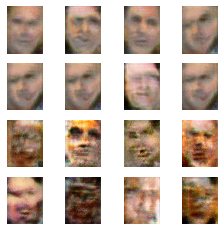

Epoch: 50,	 G Loss: -6.69850,	 D Loss: -13.15110,  D_Real_loss: -24.33279,  D_Fake_loss: 11.18169,	 G_fake_loss -9.00286,	 G_dist: 2.55990,	 G_pen: 2.30436


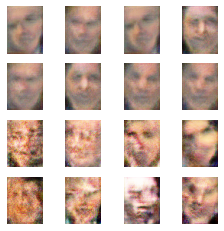

Epoch: 51,	 G Loss: -18.03564,	 D Loss: -8.89085,  D_Real_loss: -32.41133,  D_Fake_loss: 23.52048,	 G_fake_loss -24.02308,	 G_dist: 2.49237,	 G_pen: 5.98744


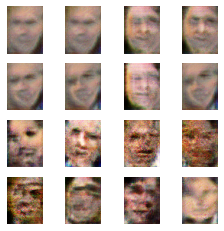

Epoch: 51,	 G Loss: 8.06780,	 D Loss: -6.94312,  D_Real_loss: 1.94131,  D_Fake_loss: -8.88443,	 G_fake_loss 8.06716,	 G_dist: 2.51442,	 G_pen: 0.00064


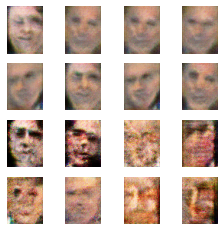

Epoch: 51,	 G Loss: 22.51946,	 D Loss: -6.94162,  D_Real_loss: 15.57933,  D_Fake_loss: -22.52095,	 G_fake_loss 22.51946,	 G_dist: 2.56166,	 G_pen: 0.00000


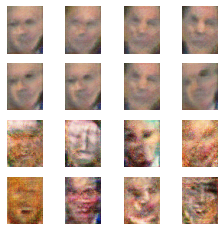

Epoch: 51,	 G Loss: 30.12710,	 D Loss: -9.12778,  D_Real_loss: 21.98851,  D_Fake_loss: -31.11630,	 G_fake_loss 30.12710,	 G_dist: 2.56774,	 G_pen: 0.00000


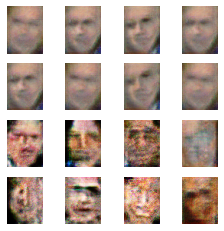

Epoch: 52,	 G Loss: 35.43947,	 D Loss: -7.44213,  D_Real_loss: 27.90851,  D_Fake_loss: -35.35064,	 G_fake_loss 35.43947,	 G_dist: 2.53061,	 G_pen: 0.00000


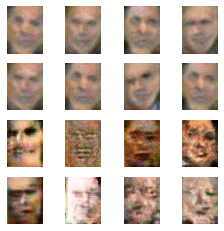

Epoch: 52,	 G Loss: 3.80689,	 D Loss: -9.34645,  D_Real_loss: -6.48277,  D_Fake_loss: -2.86369,	 G_fake_loss 3.78528,	 G_dist: 2.57211,	 G_pen: 0.02161


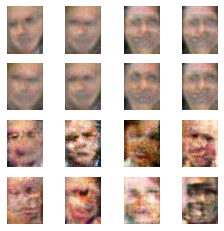

Epoch: 52,	 G Loss: -1.73399,	 D Loss: -7.80586,  D_Real_loss: -9.28625,  D_Fake_loss: 1.48040,	 G_fake_loss -2.27585,	 G_dist: 2.62547,	 G_pen: 0.54186


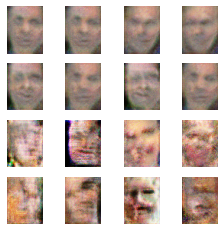

Epoch: 52,	 G Loss: 30.28991,	 D Loss: -7.11287,  D_Real_loss: 24.42413,  D_Fake_loss: -31.53700,	 G_fake_loss 30.28991,	 G_dist: 2.56518,	 G_pen: 0.00000


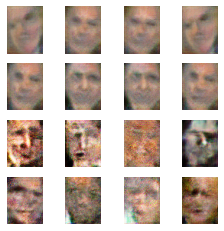

Epoch: 53,	 G Loss: 41.98861,	 D Loss: -11.49459,  D_Real_loss: 30.78605,  D_Fake_loss: -42.28064,	 G_fake_loss 41.98861,	 G_dist: 2.58364,	 G_pen: 0.00000


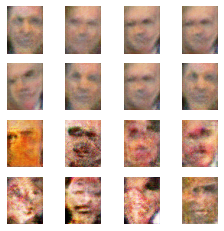

Epoch: 53,	 G Loss: 29.29860,	 D Loss: -5.04109,  D_Real_loss: 20.28061,  D_Fake_loss: -25.32170,	 G_fake_loss 29.29860,	 G_dist: 2.63662,	 G_pen: 0.00000


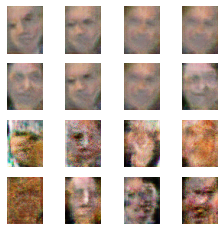

Epoch: 53,	 G Loss: 27.84119,	 D Loss: -6.07391,  D_Real_loss: 21.76187,  D_Fake_loss: -27.83578,	 G_fake_loss 27.84119,	 G_dist: 2.58455,	 G_pen: 0.00000


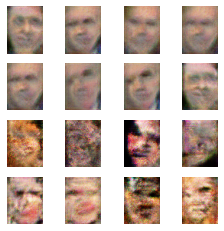

Epoch: 53,	 G Loss: 30.90755,	 D Loss: -8.25585,  D_Real_loss: 23.12748,  D_Fake_loss: -31.38333,	 G_fake_loss 30.90755,	 G_dist: 2.58203,	 G_pen: 0.00000


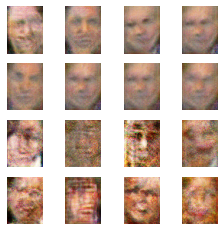

Epoch: 54,	 G Loss: 12.76172,	 D Loss: -13.06898,  D_Real_loss: -0.72962,  D_Fake_loss: -12.33936,	 G_fake_loss 12.76171,	 G_dist: 2.63277,	 G_pen: 0.00001


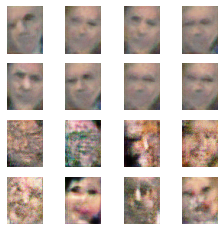

Epoch: 54,	 G Loss: 2.79954,	 D Loss: -10.05067,  D_Real_loss: -9.59822,  D_Fake_loss: -0.45244,	 G_fake_loss 2.75784,	 G_dist: 2.53470,	 G_pen: 0.04169


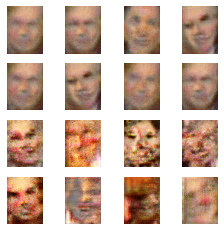

Epoch: 54,	 G Loss: -11.02605,	 D Loss: -10.05100,  D_Real_loss: -24.59730,  D_Fake_loss: 14.54630,	 G_fake_loss -14.92502,	 G_dist: 2.61237,	 G_pen: 3.89897


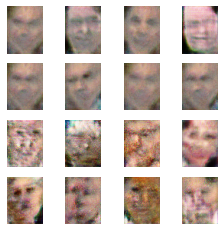

Epoch: 54,	 G Loss: 42.69072,	 D Loss: -8.12821,  D_Real_loss: 31.81678,  D_Fake_loss: -39.94499,	 G_fake_loss 42.69072,	 G_dist: 2.54887,	 G_pen: 0.00000


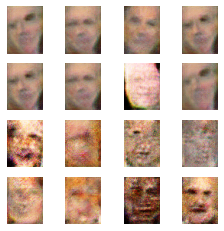

Epoch: 55,	 G Loss: 4.51244,	 D Loss: -6.96212,  D_Real_loss: -3.86791,  D_Fake_loss: -3.09421,	 G_fake_loss 4.49961,	 G_dist: 2.59380,	 G_pen: 0.01283


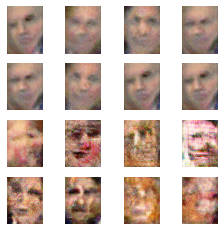

Epoch: 55,	 G Loss: 15.98341,	 D Loss: -5.93168,  D_Real_loss: 8.99337,  D_Fake_loss: -14.92505,	 G_fake_loss 15.98341,	 G_dist: 2.55613,	 G_pen: 0.00000


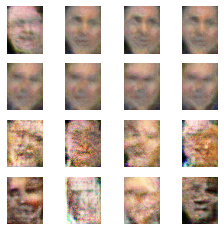

Epoch: 55,	 G Loss: 9.72396,	 D Loss: -8.00385,  D_Real_loss: 2.39994,  D_Fake_loss: -10.40379,	 G_fake_loss 9.72381,	 G_dist: 2.55552,	 G_pen: 0.00015


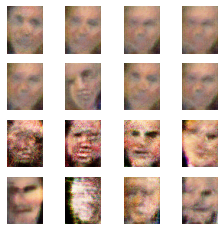

Epoch: 55,	 G Loss: 33.96151,	 D Loss: -7.77171,  D_Real_loss: 25.42947,  D_Fake_loss: -33.20117,	 G_fake_loss 33.96151,	 G_dist: 2.57129,	 G_pen: 0.00000


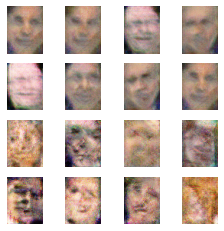

Epoch: 56,	 G Loss: 32.32223,	 D Loss: -6.89469,  D_Real_loss: 23.07796,  D_Fake_loss: -29.97264,	 G_fake_loss 32.32223,	 G_dist: 2.60124,	 G_pen: 0.00000


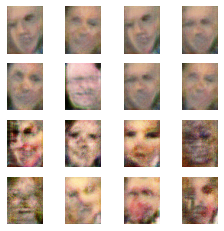

Epoch: 56,	 G Loss: 24.15830,	 D Loss: -9.16191,  D_Real_loss: 13.23871,  D_Fake_loss: -22.40062,	 G_fake_loss 24.15830,	 G_dist: 2.62493,	 G_pen: 0.00000


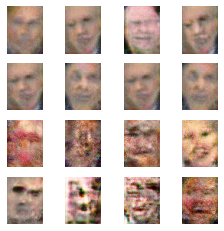

Epoch: 56,	 G Loss: 40.93348,	 D Loss: -4.63194,  D_Real_loss: 34.37909,  D_Fake_loss: -39.01103,	 G_fake_loss 40.93348,	 G_dist: 2.56791,	 G_pen: 0.00000


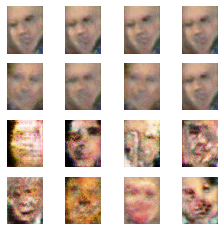

Epoch: 56,	 G Loss: 13.65568,	 D Loss: -11.89111,  D_Real_loss: 1.66381,  D_Fake_loss: -13.55492,	 G_fake_loss 13.65568,	 G_dist: 2.55360,	 G_pen: 0.00000


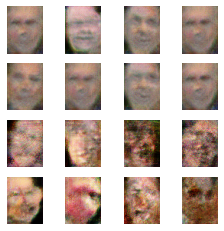

Epoch: 57,	 G Loss: -1.67524,	 D Loss: -7.65357,  D_Real_loss: -10.29646,  D_Fake_loss: 2.64288,	 G_fake_loss -2.17523,	 G_dist: 2.55967,	 G_pen: 0.50000


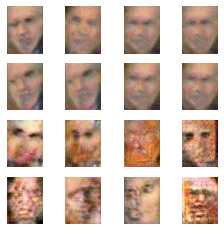

Epoch: 57,	 G Loss: 16.60918,	 D Loss: -8.48667,  D_Real_loss: 7.07811,  D_Fake_loss: -15.56478,	 G_fake_loss 16.60918,	 G_dist: 2.60646,	 G_pen: 0.00000


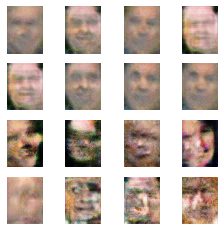

Epoch: 57,	 G Loss: 56.56113,	 D Loss: -11.60458,  D_Real_loss: 44.68348,  D_Fake_loss: -56.28805,	 G_fake_loss 56.56113,	 G_dist: 2.57433,	 G_pen: 0.00000


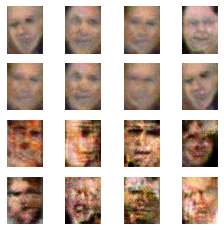

Epoch: 57,	 G Loss: 40.13601,	 D Loss: -6.34406,  D_Real_loss: 30.41758,  D_Fake_loss: -36.76163,	 G_fake_loss 40.13601,	 G_dist: 2.62938,	 G_pen: 0.00000


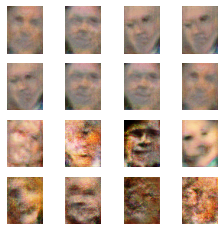

Epoch: 58,	 G Loss: 27.23935,	 D Loss: -13.26069,  D_Real_loss: 13.63797,  D_Fake_loss: -26.89865,	 G_fake_loss 27.23935,	 G_dist: 2.57144,	 G_pen: 0.00000


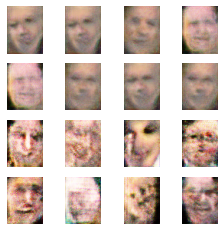

Epoch: 58,	 G Loss: -22.20203,	 D Loss: -16.67579,  D_Real_loss: -47.36606,  D_Fake_loss: 30.69027,	 G_fake_loss -29.89201,	 G_dist: 2.57259,	 G_pen: 7.68998


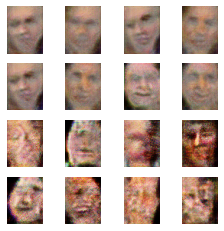

Epoch: 58,	 G Loss: -23.42616,	 D Loss: -11.52322,  D_Real_loss: -42.56968,  D_Fake_loss: 31.04646,	 G_fake_loss -31.33482,	 G_dist: 2.52392,	 G_pen: 7.90866


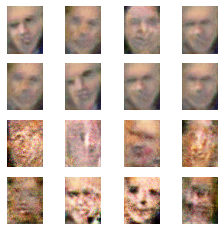

Epoch: 58,	 G Loss: 10.43633,	 D Loss: -7.15343,  D_Real_loss: 3.18756,  D_Fake_loss: -10.34099,	 G_fake_loss 10.43626,	 G_dist: 2.45219,	 G_pen: 0.00008


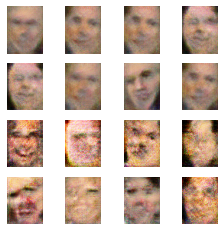

Epoch: 59,	 G Loss: 7.72452,	 D Loss: -9.88894,  D_Real_loss: -1.17935,  D_Fake_loss: -8.70959,	 G_fake_loss 7.72363,	 G_dist: 2.59910,	 G_pen: 0.00089


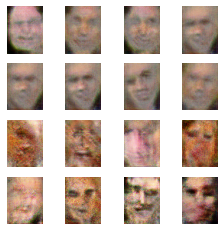

Epoch: 59,	 G Loss: 29.58784,	 D Loss: -9.02097,  D_Real_loss: 15.04604,  D_Fake_loss: -24.06701,	 G_fake_loss 29.58784,	 G_dist: 2.56539,	 G_pen: 0.00000


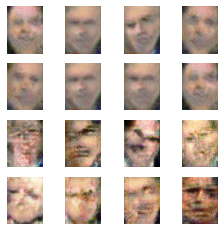

Epoch: 59,	 G Loss: 29.01172,	 D Loss: -6.43895,  D_Real_loss: 21.42770,  D_Fake_loss: -27.86665,	 G_fake_loss 29.01172,	 G_dist: 2.56183,	 G_pen: 0.00000


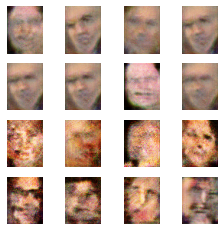

Epoch: 59,	 G Loss: 40.21955,	 D Loss: -6.91108,  D_Real_loss: 31.46885,  D_Fake_loss: -38.37993,	 G_fake_loss 40.21955,	 G_dist: 2.62948,	 G_pen: 0.00000


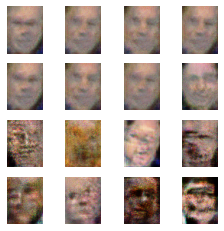

Epoch: 59,	 Generator Loss: 38.254676818847656,	 Discriminator Loss: -8.519784927368164
Total time to epoch 60 is 78.89055040280024 min
Epoch: 60,	 G Loss: 32.09711,	 D Loss: -12.06637,  D_Real_loss: 21.33114,  D_Fake_loss: -33.39751,	 G_fake_loss 32.09711,	 G_dist: 2.57371,	 G_pen: 0.00000


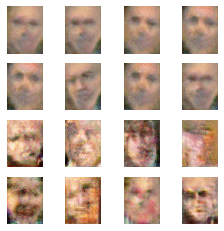

Epoch: 60,	 G Loss: 17.40506,	 D Loss: -13.04041,  D_Real_loss: 0.78068,  D_Fake_loss: -13.82109,	 G_fake_loss 17.40506,	 G_dist: 2.56763,	 G_pen: 0.00000


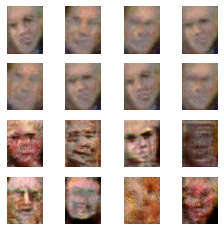

Epoch: 60,	 G Loss: -2.54666,	 D Loss: -9.88442,  D_Real_loss: -17.24716,  D_Fake_loss: 7.36274,	 G_fake_loss -3.41040,	 G_dist: 2.61629,	 G_pen: 0.86373


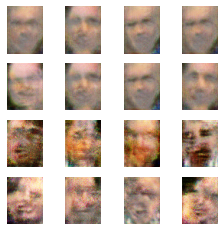

Epoch: 60,	 G Loss: 4.12004,	 D Loss: -8.09380,  D_Real_loss: -2.70123,  D_Fake_loss: -5.39257,	 G_fake_loss 4.10281,	 G_dist: 2.58321,	 G_pen: 0.01723


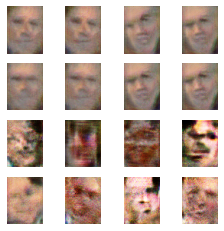

Epoch: 61,	 G Loss: 19.11901,	 D Loss: -5.36334,  D_Real_loss: 15.23379,  D_Fake_loss: -20.59713,	 G_fake_loss 19.11901,	 G_dist: 2.59348,	 G_pen: 0.00000


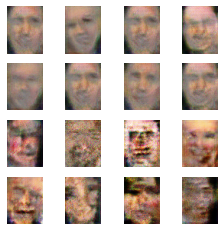

Epoch: 61,	 G Loss: 27.04819,	 D Loss: -11.79613,  D_Real_loss: 17.60516,  D_Fake_loss: -29.40128,	 G_fake_loss 27.04819,	 G_dist: 2.57946,	 G_pen: 0.00000


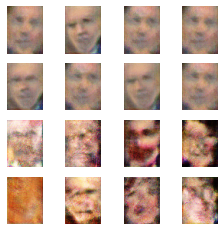

Epoch: 61,	 G Loss: 52.05753,	 D Loss: -8.59788,  D_Real_loss: 39.51709,  D_Fake_loss: -48.11497,	 G_fake_loss 52.05753,	 G_dist: 2.57215,	 G_pen: 0.00000


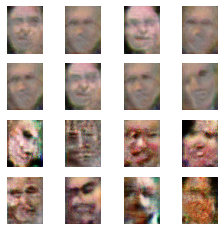

Epoch: 61,	 G Loss: 59.14466,	 D Loss: -10.96897,  D_Real_loss: 47.47966,  D_Fake_loss: -58.44863,	 G_fake_loss 59.14466,	 G_dist: 2.59522,	 G_pen: 0.00000


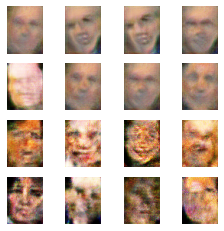

Epoch: 62,	 G Loss: 13.43903,	 D Loss: -8.52174,  D_Real_loss: 3.90492,  D_Fake_loss: -12.42666,	 G_fake_loss 13.43902,	 G_dist: 2.65391,	 G_pen: 0.00001


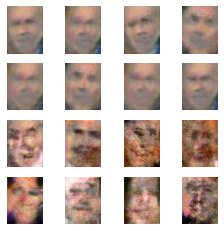

Epoch: 62,	 G Loss: 46.76793,	 D Loss: -6.18761,  D_Real_loss: 38.83356,  D_Fake_loss: -45.02117,	 G_fake_loss 46.76793,	 G_dist: 2.54505,	 G_pen: 0.00000


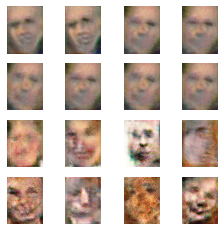

Epoch: 62,	 G Loss: 40.97960,	 D Loss: -7.87051,  D_Real_loss: 33.71795,  D_Fake_loss: -41.58846,	 G_fake_loss 40.97960,	 G_dist: 2.58163,	 G_pen: 0.00000


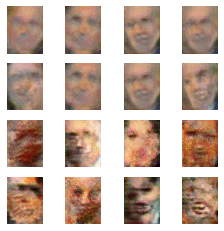

Epoch: 62,	 G Loss: 49.96207,	 D Loss: -9.46837,  D_Real_loss: 38.90347,  D_Fake_loss: -48.37184,	 G_fake_loss 49.96207,	 G_dist: 2.57746,	 G_pen: 0.00000


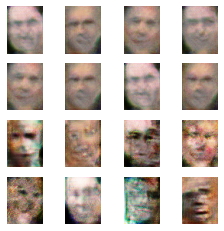

Epoch: 63,	 G Loss: 27.35733,	 D Loss: -7.94957,  D_Real_loss: 19.11914,  D_Fake_loss: -27.06871,	 G_fake_loss 27.35733,	 G_dist: 2.62736,	 G_pen: 0.00000


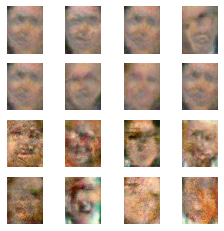

Epoch: 63,	 G Loss: 27.69448,	 D Loss: -9.09575,  D_Real_loss: 20.39251,  D_Fake_loss: -29.48826,	 G_fake_loss 27.69448,	 G_dist: 2.55275,	 G_pen: 0.00000


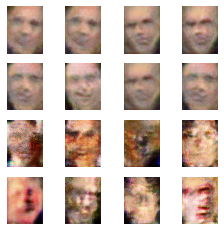

Epoch: 63,	 G Loss: 31.16159,	 D Loss: -9.73036,  D_Real_loss: 21.63706,  D_Fake_loss: -31.36742,	 G_fake_loss 31.16159,	 G_dist: 2.65828,	 G_pen: 0.00000


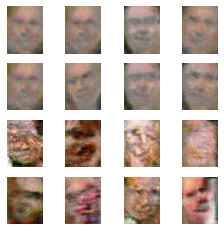

Epoch: 63,	 G Loss: 49.76931,	 D Loss: -7.70866,  D_Real_loss: 43.04198,  D_Fake_loss: -50.75064,	 G_fake_loss 49.76931,	 G_dist: 2.53975,	 G_pen: 0.00000


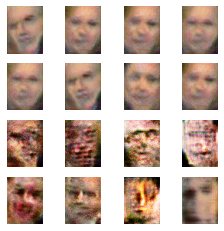

Epoch: 64,	 G Loss: -16.95825,	 D Loss: -10.77470,  D_Real_loss: -36.75590,  D_Fake_loss: 25.98119,	 G_fake_loss -23.08017,	 G_dist: 2.65246,	 G_pen: 6.12193


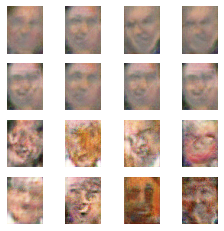

Epoch: 64,	 G Loss: 10.25477,	 D Loss: -7.26601,  D_Real_loss: 5.39338,  D_Fake_loss: -12.65939,	 G_fake_loss 10.25468,	 G_dist: 2.56513,	 G_pen: 0.00009


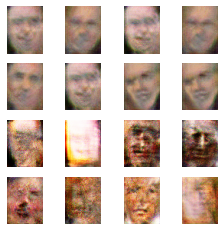

Epoch: 64,	 G Loss: 51.59739,	 D Loss: -5.95253,  D_Real_loss: 45.30381,  D_Fake_loss: -51.25634,	 G_fake_loss 51.59739,	 G_dist: 2.61740,	 G_pen: 0.00000


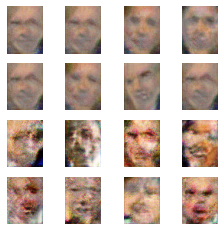

Epoch: 64,	 G Loss: 37.14147,	 D Loss: -9.31234,  D_Real_loss: 27.72644,  D_Fake_loss: -37.03878,	 G_fake_loss 37.14147,	 G_dist: 2.61639,	 G_pen: 0.00000


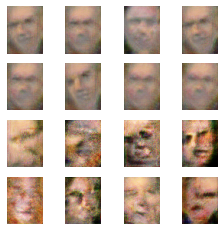

Epoch: 65,	 G Loss: 23.42834,	 D Loss: -7.04713,  D_Real_loss: 16.77577,  D_Fake_loss: -23.82290,	 G_fake_loss 23.42834,	 G_dist: 2.61889,	 G_pen: 0.00000


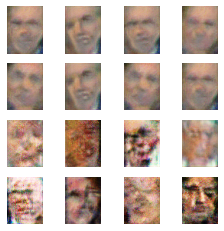

Epoch: 65,	 G Loss: 42.79402,	 D Loss: -8.47094,  D_Real_loss: 34.91207,  D_Fake_loss: -43.38300,	 G_fake_loss 42.79402,	 G_dist: 2.57778,	 G_pen: 0.00000


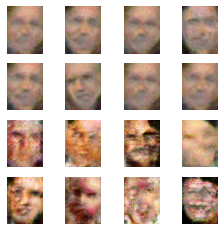

Epoch: 65,	 G Loss: 29.21502,	 D Loss: -6.84624,  D_Real_loss: 22.42853,  D_Fake_loss: -29.27478,	 G_fake_loss 29.21502,	 G_dist: 2.64366,	 G_pen: 0.00000


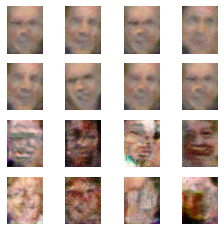

Epoch: 65,	 G Loss: 27.01155,	 D Loss: -6.72587,  D_Real_loss: 20.34836,  D_Fake_loss: -27.07424,	 G_fake_loss 27.01155,	 G_dist: 2.60410,	 G_pen: 0.00000


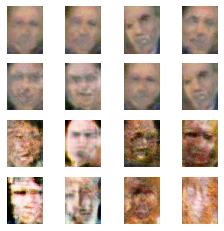

Epoch: 66,	 G Loss: 37.37732,	 D Loss: -6.80755,  D_Real_loss: 30.42846,  D_Fake_loss: -37.23600,	 G_fake_loss 37.37732,	 G_dist: 2.63191,	 G_pen: 0.00000


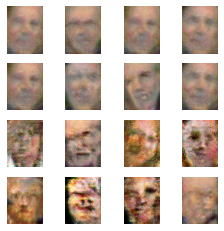

Epoch: 66,	 G Loss: 26.89043,	 D Loss: -7.43044,  D_Real_loss: 20.10209,  D_Fake_loss: -27.53253,	 G_fake_loss 26.89043,	 G_dist: 2.61489,	 G_pen: 0.00000


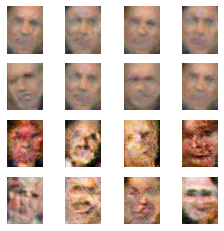

Epoch: 66,	 G Loss: 30.46087,	 D Loss: -7.43032,  D_Real_loss: 22.49281,  D_Fake_loss: -29.92313,	 G_fake_loss 30.46087,	 G_dist: 2.64349,	 G_pen: 0.00000


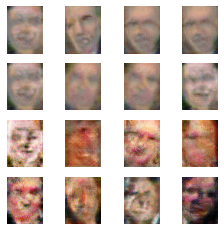

Epoch: 66,	 G Loss: 39.59635,	 D Loss: -7.54109,  D_Real_loss: 32.59658,  D_Fake_loss: -40.13766,	 G_fake_loss 39.59635,	 G_dist: 2.62711,	 G_pen: 0.00000


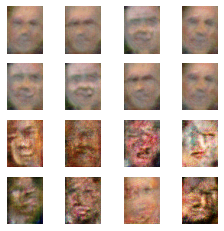

Epoch: 67,	 G Loss: 50.75645,	 D Loss: -6.77428,  D_Real_loss: 44.97822,  D_Fake_loss: -51.75250,	 G_fake_loss 50.75645,	 G_dist: 2.58441,	 G_pen: 0.00000


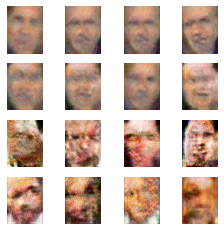

Epoch: 67,	 G Loss: -2.91408,	 D Loss: -12.35985,  D_Real_loss: -19.06007,  D_Fake_loss: 6.70022,	 G_fake_loss -3.93146,	 G_dist: 2.63856,	 G_pen: 1.01738


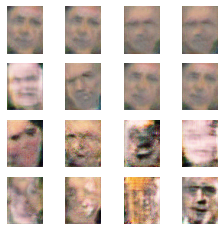

Epoch: 67,	 G Loss: 6.75860,	 D Loss: -11.82622,  D_Real_loss: -3.15400,  D_Fake_loss: -8.67222,	 G_fake_loss 6.75658,	 G_dist: 2.57095,	 G_pen: 0.00202


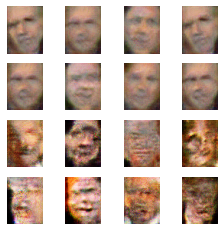

Epoch: 67,	 G Loss: 16.57783,	 D Loss: -9.18662,  D_Real_loss: 7.83263,  D_Fake_loss: -17.01926,	 G_fake_loss 16.57783,	 G_dist: 2.60378,	 G_pen: 0.00000


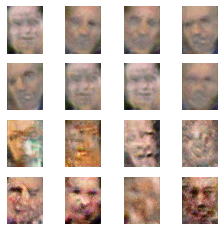

Epoch: 68,	 G Loss: 48.19585,	 D Loss: -6.57543,  D_Real_loss: 41.90331,  D_Fake_loss: -48.47873,	 G_fake_loss 48.19585,	 G_dist: 2.60443,	 G_pen: 0.00000


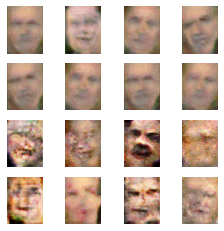

Epoch: 68,	 G Loss: 45.67905,	 D Loss: -10.94214,  D_Real_loss: 35.33746,  D_Fake_loss: -46.27959,	 G_fake_loss 45.67905,	 G_dist: 2.61146,	 G_pen: 0.00000


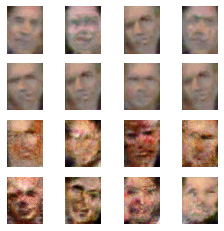

Epoch: 68,	 G Loss: 36.12775,	 D Loss: -3.89427,  D_Real_loss: 26.87467,  D_Fake_loss: -30.76895,	 G_fake_loss 36.12775,	 G_dist: 2.61796,	 G_pen: 0.00000


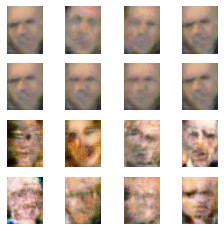

Epoch: 68,	 G Loss: -30.35046,	 D Loss: -5.79250,  D_Real_loss: -43.86524,  D_Fake_loss: 38.07275,	 G_fake_loss -40.89533,	 G_dist: 2.57850,	 G_pen: 10.54487


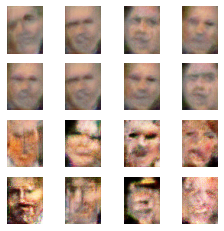

Epoch: 69,	 G Loss: -8.56937,	 D Loss: -7.25542,  D_Real_loss: -15.54900,  D_Fake_loss: 8.29358,	 G_fake_loss -11.36724,	 G_dist: 2.46137,	 G_pen: 2.79787


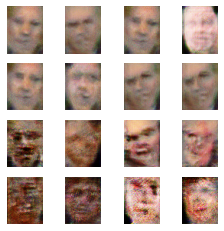

Epoch: 69,	 G Loss: 8.74724,	 D Loss: -10.19515,  D_Real_loss: -1.71759,  D_Fake_loss: -8.47756,	 G_fake_loss 8.74689,	 G_dist: 2.53951,	 G_pen: 0.00035


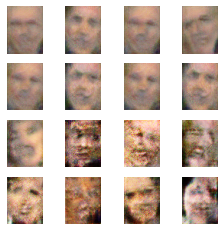

Epoch: 69,	 G Loss: 16.36930,	 D Loss: -9.22104,  D_Real_loss: 8.37356,  D_Fake_loss: -17.59460,	 G_fake_loss 16.36930,	 G_dist: 2.55357,	 G_pen: 0.00000


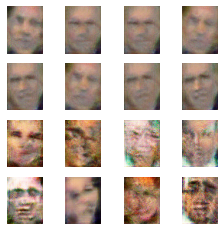

Epoch: 69,	 G Loss: 36.34254,	 D Loss: -8.89322,  D_Real_loss: 27.24625,  D_Fake_loss: -36.13947,	 G_fake_loss 36.34254,	 G_dist: 2.58547,	 G_pen: 0.00000


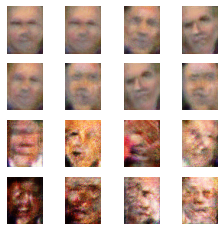

Epoch: 69,	 Generator Loss: 35.697296142578125,	 Discriminator Loss: -5.32073974609375
Total time to epoch 70 is 92.00433866182964 min
Epoch: 70,	 G Loss: 28.01405,	 D Loss: -7.14471,  D_Real_loss: 21.07608,  D_Fake_loss: -28.22079,	 G_fake_loss 28.01405,	 G_dist: 2.64790,	 G_pen: 0.00000


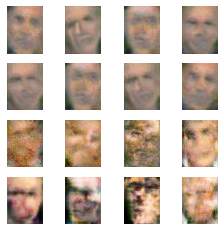

Epoch: 70,	 G Loss: 73.52425,	 D Loss: -7.82407,  D_Real_loss: 65.41807,  D_Fake_loss: -73.24214,	 G_fake_loss 73.52425,	 G_dist: 2.58339,	 G_pen: 0.00000


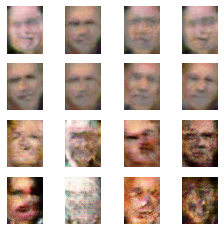

Epoch: 70,	 G Loss: 14.20861,	 D Loss: -8.55960,  D_Real_loss: 1.44336,  D_Fake_loss: -10.00296,	 G_fake_loss 14.20861,	 G_dist: 2.67297,	 G_pen: 0.00000


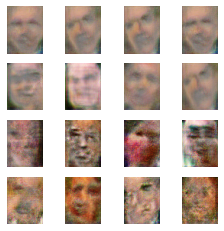

Epoch: 70,	 G Loss: 17.38860,	 D Loss: -7.09141,  D_Real_loss: 11.57743,  D_Fake_loss: -18.66884,	 G_fake_loss 17.38860,	 G_dist: 2.54252,	 G_pen: 0.00000


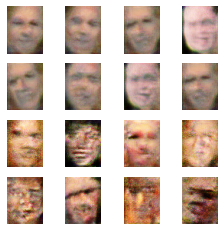

Epoch: 71,	 G Loss: 20.61528,	 D Loss: -7.65202,  D_Real_loss: 14.54537,  D_Fake_loss: -22.19738,	 G_fake_loss 20.61528,	 G_dist: 2.61829,	 G_pen: 0.00000


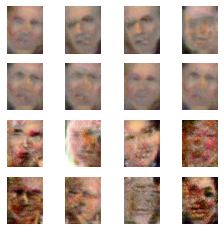

Epoch: 71,	 G Loss: 63.27155,	 D Loss: -7.63737,  D_Real_loss: 57.76400,  D_Fake_loss: -65.40137,	 G_fake_loss 63.27155,	 G_dist: 2.58301,	 G_pen: 0.00000


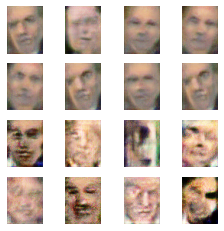

Epoch: 71,	 G Loss: 40.17398,	 D Loss: -12.65041,  D_Real_loss: 28.88141,  D_Fake_loss: -41.53182,	 G_fake_loss 40.17398,	 G_dist: 2.59514,	 G_pen: 0.00000


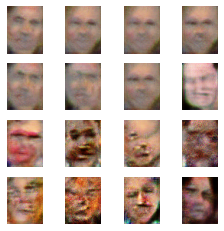

Epoch: 71,	 G Loss: 29.70104,	 D Loss: -13.01777,  D_Real_loss: 16.43703,  D_Fake_loss: -29.45479,	 G_fake_loss 29.70104,	 G_dist: 2.64382,	 G_pen: 0.00000


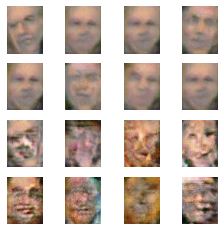

Epoch: 72,	 G Loss: 20.18595,	 D Loss: -6.45604,  D_Real_loss: 12.31360,  D_Fake_loss: -18.76964,	 G_fake_loss 20.18595,	 G_dist: 2.61939,	 G_pen: 0.00000


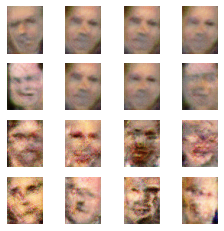

Epoch: 72,	 G Loss: -3.62443,	 D Loss: -6.69994,  D_Real_loss: -11.40249,  D_Fake_loss: 4.70256,	 G_fake_loss -4.89385,	 G_dist: 2.61335,	 G_pen: 1.26942


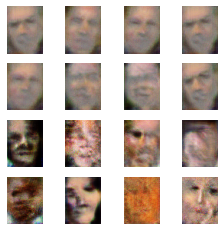

Epoch: 72,	 G Loss: 42.70475,	 D Loss: -8.41032,  D_Real_loss: 37.74652,  D_Fake_loss: -46.15684,	 G_fake_loss 42.70475,	 G_dist: 2.58511,	 G_pen: 0.00000


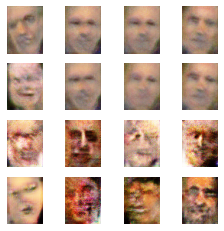

Epoch: 72,	 G Loss: 59.84002,	 D Loss: -11.52266,  D_Real_loss: 50.97615,  D_Fake_loss: -62.49881,	 G_fake_loss 59.84002,	 G_dist: 2.61705,	 G_pen: 0.00000


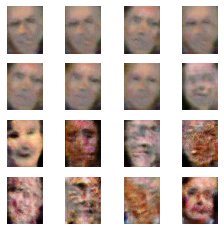

Epoch: 73,	 G Loss: 64.40185,	 D Loss: -10.52440,  D_Real_loss: 55.19904,  D_Fake_loss: -65.72344,	 G_fake_loss 64.40185,	 G_dist: 2.59627,	 G_pen: 0.00000


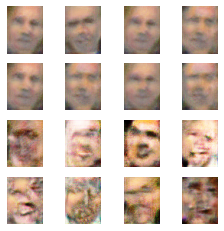

Epoch: 73,	 G Loss: 50.97357,	 D Loss: -10.45068,  D_Real_loss: 40.15763,  D_Fake_loss: -50.60831,	 G_fake_loss 50.97357,	 G_dist: 2.59411,	 G_pen: 0.00000


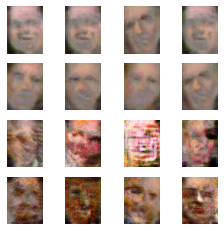

Epoch: 73,	 G Loss: 34.42554,	 D Loss: -11.30771,  D_Real_loss: 22.39230,  D_Fake_loss: -33.70001,	 G_fake_loss 34.42554,	 G_dist: 2.60298,	 G_pen: 0.00000


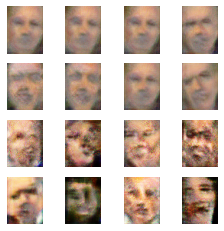

Epoch: 73,	 G Loss: 7.78515,	 D Loss: -8.85965,  D_Real_loss: -1.02209,  D_Fake_loss: -7.83756,	 G_fake_loss 7.78429,	 G_dist: 2.64400,	 G_pen: 0.00086


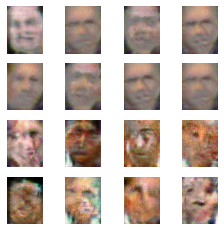

Epoch: 74,	 G Loss: 0.95307,	 D Loss: -5.12627,  D_Real_loss: -4.74010,  D_Fake_loss: -0.38617,	 G_fake_loss 0.88614,	 G_dist: 2.58776,	 G_pen: 0.06694


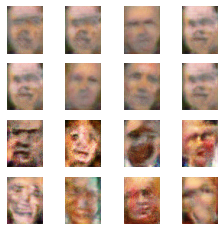

Epoch: 74,	 G Loss: 28.32497,	 D Loss: -9.39560,  D_Real_loss: 19.39404,  D_Fake_loss: -28.78964,	 G_fake_loss 28.32497,	 G_dist: 2.63347,	 G_pen: 0.00000


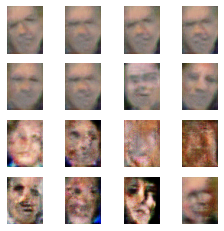

Epoch: 74,	 G Loss: 49.12778,	 D Loss: -7.77758,  D_Real_loss: 42.52070,  D_Fake_loss: -50.29828,	 G_fake_loss 49.12778,	 G_dist: 2.63475,	 G_pen: 0.00000


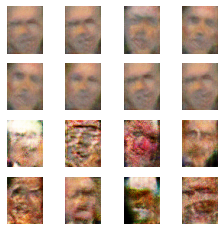

Epoch: 74,	 G Loss: 27.94521,	 D Loss: -9.87442,  D_Real_loss: 17.15204,  D_Fake_loss: -27.02647,	 G_fake_loss 27.94521,	 G_dist: 2.66339,	 G_pen: 0.00000


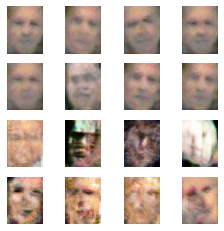

Epoch: 75,	 G Loss: 25.90593,	 D Loss: -5.48849,  D_Real_loss: 20.23830,  D_Fake_loss: -25.72679,	 G_fake_loss 25.90593,	 G_dist: 2.60453,	 G_pen: 0.00000


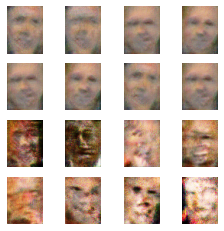

Epoch: 75,	 G Loss: 37.25673,	 D Loss: -7.14573,  D_Real_loss: 30.10925,  D_Fake_loss: -37.25498,	 G_fake_loss 37.25673,	 G_dist: 2.63517,	 G_pen: 0.00000


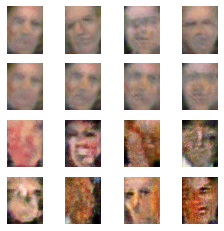

Epoch: 75,	 G Loss: 44.14641,	 D Loss: -7.30292,  D_Real_loss: 35.31865,  D_Fake_loss: -42.62157,	 G_fake_loss 44.14641,	 G_dist: 2.63817,	 G_pen: 0.00000


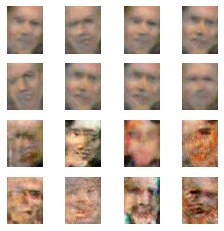

Epoch: 75,	 G Loss: 36.28701,	 D Loss: -6.11403,  D_Real_loss: 29.43657,  D_Fake_loss: -35.55060,	 G_fake_loss 36.28701,	 G_dist: 2.61083,	 G_pen: 0.00000


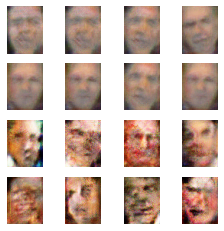

Epoch: 76,	 G Loss: 32.28777,	 D Loss: -7.77652,  D_Real_loss: 24.03562,  D_Fake_loss: -31.81214,	 G_fake_loss 32.28777,	 G_dist: 2.68079,	 G_pen: 0.00000


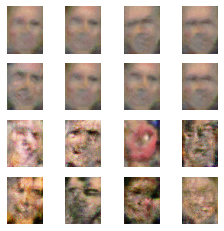

Epoch: 76,	 G Loss: 33.62574,	 D Loss: -7.46552,  D_Real_loss: 26.66679,  D_Fake_loss: -34.13231,	 G_fake_loss 33.62574,	 G_dist: 2.62115,	 G_pen: 0.00000


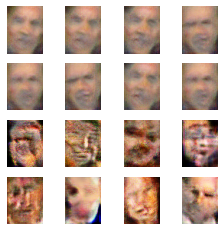

Epoch: 76,	 G Loss: 38.75161,	 D Loss: -9.49687,  D_Real_loss: 27.96416,  D_Fake_loss: -37.46103,	 G_fake_loss 38.75161,	 G_dist: 2.64823,	 G_pen: 0.00000


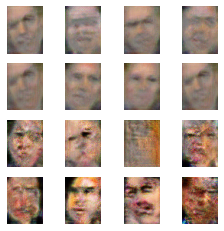

Epoch: 76,	 G Loss: 74.28959,	 D Loss: -7.93901,  D_Real_loss: 69.43323,  D_Fake_loss: -77.37224,	 G_fake_loss 74.28959,	 G_dist: 2.59188,	 G_pen: 0.00000


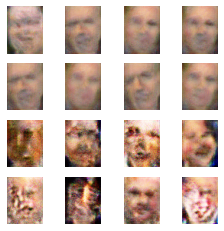

Epoch: 77,	 G Loss: 22.50685,	 D Loss: -7.39703,  D_Real_loss: 14.22942,  D_Fake_loss: -21.62645,	 G_fake_loss 22.50685,	 G_dist: 2.62635,	 G_pen: 0.00000


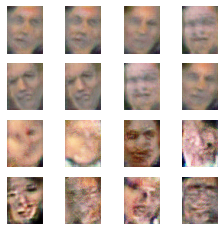

Epoch: 77,	 G Loss: -4.03951,	 D Loss: -6.73103,  D_Real_loss: -11.00380,  D_Fake_loss: 4.27277,	 G_fake_loss -5.45490,	 G_dist: 2.60582,	 G_pen: 1.41540


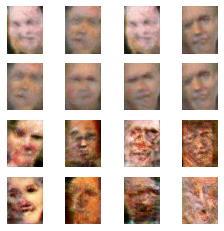

Epoch: 77,	 G Loss: 45.41919,	 D Loss: -8.71479,  D_Real_loss: 37.36813,  D_Fake_loss: -46.08292,	 G_fake_loss 45.41919,	 G_dist: 2.61754,	 G_pen: 0.00000


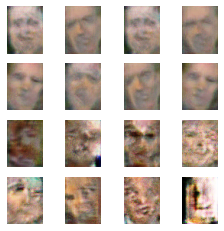

Epoch: 77,	 G Loss: 54.87695,	 D Loss: -9.07215,  D_Real_loss: 46.65549,  D_Fake_loss: -55.72764,	 G_fake_loss 54.87695,	 G_dist: 2.62153,	 G_pen: 0.00000


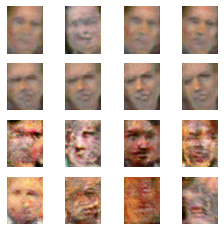

Epoch: 78,	 G Loss: 28.98793,	 D Loss: -8.43617,  D_Real_loss: 18.79449,  D_Fake_loss: -27.23065,	 G_fake_loss 28.98793,	 G_dist: 2.64134,	 G_pen: 0.00000


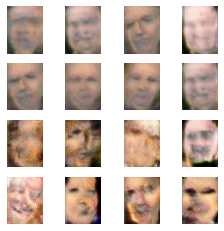

Epoch: 78,	 G Loss: 0.94864,	 D Loss: -8.22230,  D_Real_loss: -6.92671,  D_Fake_loss: -1.29558,	 G_fake_loss 0.88089,	 G_dist: 2.62517,	 G_pen: 0.06775


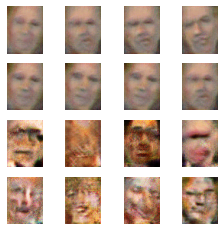

Epoch: 78,	 G Loss: 5.16900,	 D Loss: -4.02975,  D_Real_loss: -0.16001,  D_Fake_loss: -3.86974,	 G_fake_loss 5.16128,	 G_dist: 2.62368,	 G_pen: 0.00772


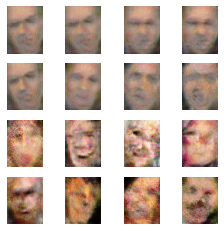

Epoch: 78,	 G Loss: 37.41351,	 D Loss: -5.18915,  D_Real_loss: 31.37424,  D_Fake_loss: -36.56339,	 G_fake_loss 37.41351,	 G_dist: 2.65227,	 G_pen: 0.00000


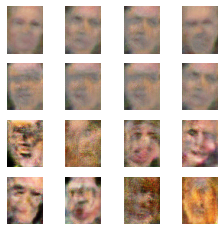

Epoch: 79,	 G Loss: 50.29955,	 D Loss: -4.91484,  D_Real_loss: 46.34957,  D_Fake_loss: -51.26441,	 G_fake_loss 50.29955,	 G_dist: 2.59926,	 G_pen: 0.00000


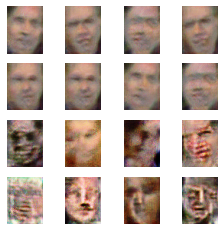

Epoch: 79,	 G Loss: 35.88007,	 D Loss: -6.96268,  D_Real_loss: 28.26935,  D_Fake_loss: -35.23203,	 G_fake_loss 35.88007,	 G_dist: 2.61257,	 G_pen: 0.00000


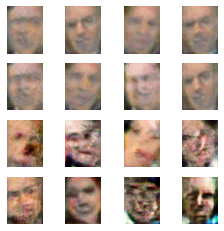

Epoch: 79,	 G Loss: 7.16417,	 D Loss: -5.91152,  D_Real_loss: 1.53873,  D_Fake_loss: -7.45025,	 G_fake_loss 7.16270,	 G_dist: 2.63784,	 G_pen: 0.00146


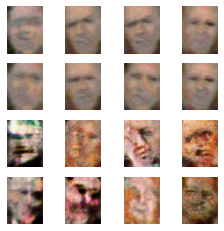

Epoch: 79,	 G Loss: 22.33878,	 D Loss: -5.51024,  D_Real_loss: 16.04374,  D_Fake_loss: -21.55398,	 G_fake_loss 22.33878,	 G_dist: 2.63096,	 G_pen: 0.00000


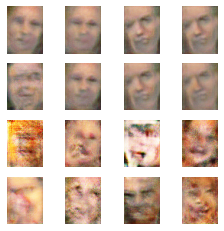

Epoch: 79,	 Generator Loss: 18.20041847229004,	 Discriminator Loss: -6.005166053771973
Total time to epoch 80 is 105.11952307224274 min
Epoch: 80,	 G Loss: -8.12573,	 D Loss: -6.65460,  D_Real_loss: -19.00929,  D_Fake_loss: 12.35469,	 G_fake_loss -11.04717,	 G_dist: 2.64456,	 G_pen: 2.92144


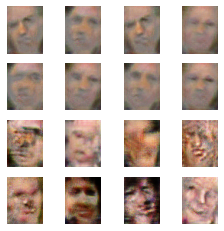

Epoch: 80,	 G Loss: 53.69545,	 D Loss: -6.36108,  D_Real_loss: 50.33749,  D_Fake_loss: -56.69856,	 G_fake_loss 53.69545,	 G_dist: 2.54468,	 G_pen: 0.00000


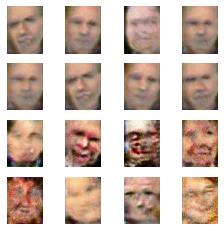

Epoch: 80,	 G Loss: 64.73396,	 D Loss: -6.00254,  D_Real_loss: 57.44057,  D_Fake_loss: -63.44311,	 G_fake_loss 64.73396,	 G_dist: 2.65918,	 G_pen: 0.00000


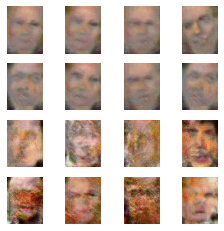

Epoch: 80,	 G Loss: 76.38201,	 D Loss: -7.41672,  D_Real_loss: 70.42843,  D_Fake_loss: -77.84515,	 G_fake_loss 76.38201,	 G_dist: 2.59307,	 G_pen: 0.00000


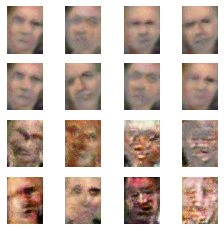

Epoch: 81,	 G Loss: 57.78350,	 D Loss: -4.84689,  D_Real_loss: 52.18668,  D_Fake_loss: -57.03357,	 G_fake_loss 57.78350,	 G_dist: 2.60491,	 G_pen: 0.00000


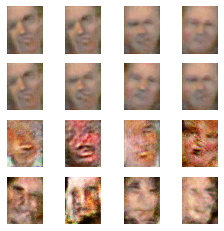

Epoch: 81,	 G Loss: 49.32127,	 D Loss: -6.87246,  D_Real_loss: 41.19227,  D_Fake_loss: -48.06473,	 G_fake_loss 49.32127,	 G_dist: 2.65161,	 G_pen: 0.00000


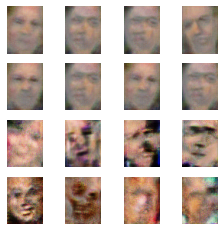

Epoch: 81,	 G Loss: 51.37958,	 D Loss: -6.15272,  D_Real_loss: 44.95106,  D_Fake_loss: -51.10378,	 G_fake_loss 51.37958,	 G_dist: 2.56727,	 G_pen: 0.00000


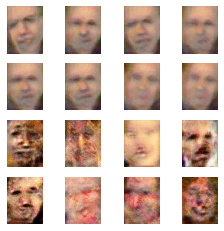

Epoch: 81,	 G Loss: 0.23525,	 D Loss: -8.32144,  D_Real_loss: -10.08727,  D_Fake_loss: 1.76583,	 G_fake_loss 0.21012,	 G_dist: 2.67166,	 G_pen: 0.02513


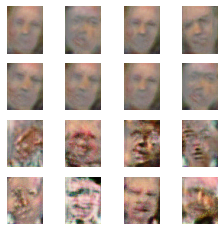

Epoch: 82,	 G Loss: 11.14795,	 D Loss: -7.01352,  D_Real_loss: 5.99001,  D_Fake_loss: -13.00353,	 G_fake_loss 11.14791,	 G_dist: 2.59807,	 G_pen: 0.00004


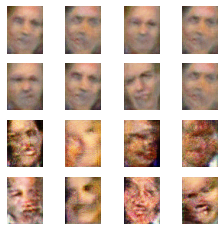

Epoch: 82,	 G Loss: 38.09170,	 D Loss: -6.32687,  D_Real_loss: 33.54929,  D_Fake_loss: -39.87617,	 G_fake_loss 38.09170,	 G_dist: 2.61396,	 G_pen: 0.00000


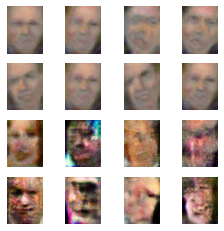

Epoch: 82,	 G Loss: 58.35309,	 D Loss: -6.61786,  D_Real_loss: 52.82526,  D_Fake_loss: -59.44312,	 G_fake_loss 58.35309,	 G_dist: 2.59278,	 G_pen: 0.00000


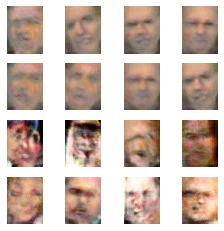

Epoch: 82,	 G Loss: 35.36226,	 D Loss: -5.90232,  D_Real_loss: 28.38557,  D_Fake_loss: -34.28790,	 G_fake_loss 35.36226,	 G_dist: 2.62466,	 G_pen: 0.00000


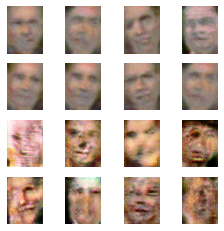

Epoch: 83,	 G Loss: 35.75422,	 D Loss: -9.62281,  D_Real_loss: 28.53588,  D_Fake_loss: -38.15869,	 G_fake_loss 35.75422,	 G_dist: 2.65122,	 G_pen: 0.00000


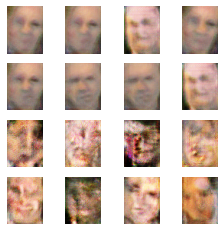

Epoch: 83,	 G Loss: 27.67335,	 D Loss: -7.09921,  D_Real_loss: 21.09334,  D_Fake_loss: -28.19255,	 G_fake_loss 27.67335,	 G_dist: 2.59816,	 G_pen: 0.00000


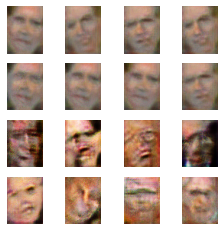

Epoch: 83,	 G Loss: 16.77842,	 D Loss: -5.90970,  D_Real_loss: 10.04385,  D_Fake_loss: -15.95355,	 G_fake_loss 16.77842,	 G_dist: 2.63530,	 G_pen: 0.00000


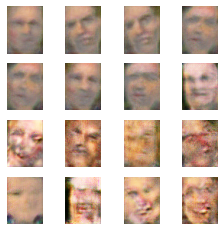

Epoch: 83,	 G Loss: 20.55430,	 D Loss: -4.99302,  D_Real_loss: 16.20916,  D_Fake_loss: -21.20219,	 G_fake_loss 20.55430,	 G_dist: 2.59298,	 G_pen: 0.00000


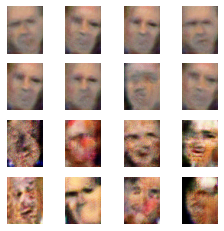

Epoch: 84,	 G Loss: 30.26321,	 D Loss: -8.56293,  D_Real_loss: 24.56921,  D_Fake_loss: -33.13214,	 G_fake_loss 30.26321,	 G_dist: 2.63323,	 G_pen: 0.00000


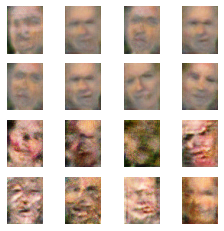

Epoch: 84,	 G Loss: 54.85336,	 D Loss: -7.26831,  D_Real_loss: 49.81205,  D_Fake_loss: -57.08036,	 G_fake_loss 54.85336,	 G_dist: 2.62168,	 G_pen: 0.00000


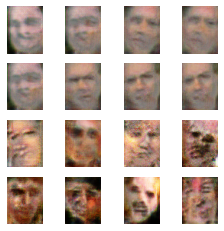

Epoch: 84,	 G Loss: 37.97848,	 D Loss: -6.37721,  D_Real_loss: 31.50732,  D_Fake_loss: -37.88453,	 G_fake_loss 37.97848,	 G_dist: 2.60946,	 G_pen: 0.00000


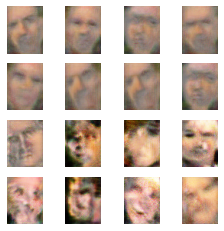

Epoch: 84,	 G Loss: 26.60278,	 D Loss: -5.48428,  D_Real_loss: 20.57075,  D_Fake_loss: -26.05503,	 G_fake_loss 26.60278,	 G_dist: 2.63594,	 G_pen: 0.00000


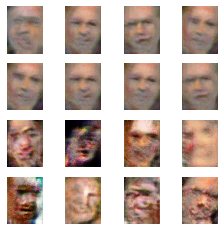

Epoch: 85,	 G Loss: 37.68135,	 D Loss: -5.12361,  D_Real_loss: 32.58828,  D_Fake_loss: -37.71189,	 G_fake_loss 37.68135,	 G_dist: 2.61387,	 G_pen: 0.00000


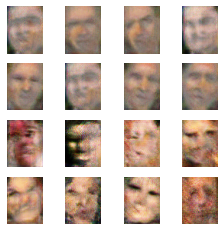

Epoch: 85,	 G Loss: 36.45930,	 D Loss: -6.46787,  D_Real_loss: 28.38981,  D_Fake_loss: -34.85768,	 G_fake_loss 36.45930,	 G_dist: 2.65837,	 G_pen: 0.00000


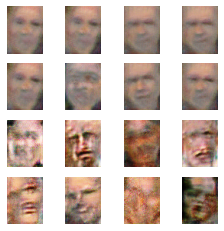

Epoch: 85,	 G Loss: 38.20862,	 D Loss: -6.12515,  D_Real_loss: 31.16772,  D_Fake_loss: -37.29287,	 G_fake_loss 38.20862,	 G_dist: 2.58101,	 G_pen: 0.00000


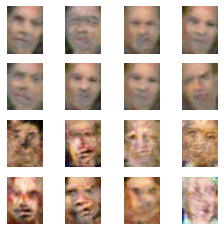

Epoch: 85,	 G Loss: 36.20461,	 D Loss: -7.74260,  D_Real_loss: 28.64425,  D_Fake_loss: -36.38685,	 G_fake_loss 36.20461,	 G_dist: 2.62164,	 G_pen: 0.00000


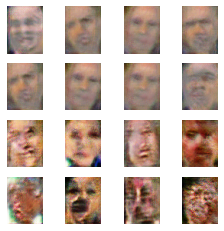

Epoch: 86,	 G Loss: 48.37629,	 D Loss: -7.87268,  D_Real_loss: 42.01632,  D_Fake_loss: -49.88900,	 G_fake_loss 48.37629,	 G_dist: 2.60650,	 G_pen: 0.00000


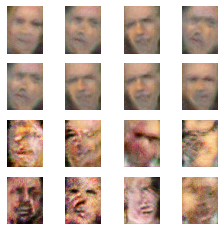

Epoch: 86,	 G Loss: 26.80926,	 D Loss: -7.33152,  D_Real_loss: 18.68753,  D_Fake_loss: -26.01905,	 G_fake_loss 26.80926,	 G_dist: 2.66279,	 G_pen: 0.00000


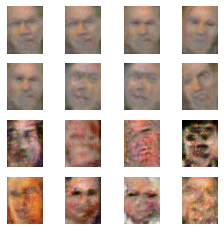

Epoch: 86,	 G Loss: 44.85400,	 D Loss: -6.66816,  D_Real_loss: 37.94502,  D_Fake_loss: -44.61318,	 G_fake_loss 44.85400,	 G_dist: 2.57832,	 G_pen: 0.00000


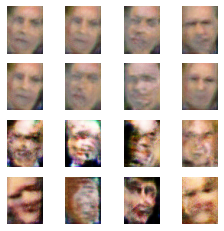

Epoch: 86,	 G Loss: 30.03913,	 D Loss: -6.74813,  D_Real_loss: 23.21009,  D_Fake_loss: -29.95822,	 G_fake_loss 30.03913,	 G_dist: 2.64985,	 G_pen: 0.00000


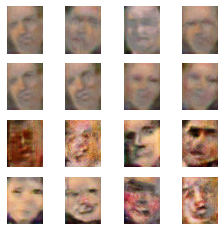

Epoch: 87,	 G Loss: 33.18922,	 D Loss: -8.78594,  D_Real_loss: 25.93563,  D_Fake_loss: -34.72158,	 G_fake_loss 33.18922,	 G_dist: 2.61423,	 G_pen: 0.00000


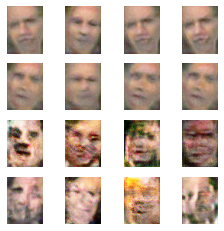

Epoch: 87,	 G Loss: 43.97500,	 D Loss: -14.07577,  D_Real_loss: 29.57288,  D_Fake_loss: -43.64865,	 G_fake_loss 43.97500,	 G_dist: 2.62925,	 G_pen: 0.00000


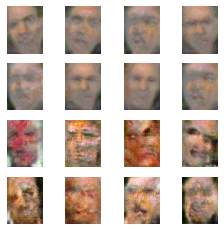

Epoch: 87,	 G Loss: 71.68179,	 D Loss: -6.88160,  D_Real_loss: 65.15852,  D_Fake_loss: -72.04012,	 G_fake_loss 71.68179,	 G_dist: 2.60739,	 G_pen: 0.00000


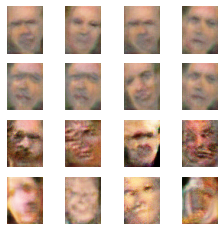

Epoch: 87,	 G Loss: 76.96238,	 D Loss: -9.02393,  D_Real_loss: 65.71000,  D_Fake_loss: -74.73393,	 G_fake_loss 76.96238,	 G_dist: 2.59629,	 G_pen: 0.00000


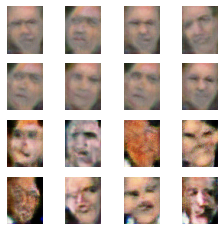

Epoch: 88,	 G Loss: 37.94504,	 D Loss: -8.14796,  D_Real_loss: 26.11311,  D_Fake_loss: -34.26107,	 G_fake_loss 37.94504,	 G_dist: 2.62951,	 G_pen: 0.00000


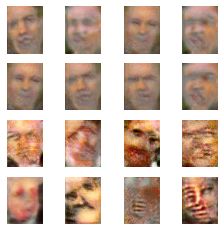

Epoch: 88,	 G Loss: 1.48682,	 D Loss: -9.32636,  D_Real_loss: -7.20379,  D_Fake_loss: -2.12257,	 G_fake_loss 1.41440,	 G_dist: 2.61857,	 G_pen: 0.07242


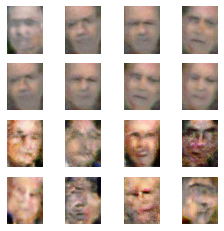

Epoch: 88,	 G Loss: 33.15698,	 D Loss: -7.39357,  D_Real_loss: 26.53067,  D_Fake_loss: -33.92424,	 G_fake_loss 33.15698,	 G_dist: 2.61894,	 G_pen: 0.00000


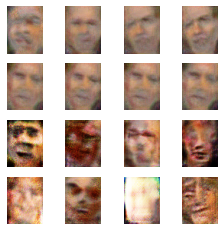

Epoch: 88,	 G Loss: 43.14690,	 D Loss: -6.85739,  D_Real_loss: 36.90930,  D_Fake_loss: -43.76669,	 G_fake_loss 43.14690,	 G_dist: 2.64104,	 G_pen: 0.00000


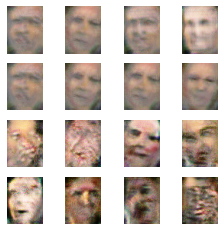

Epoch: 89,	 G Loss: 18.79894,	 D Loss: -8.21593,  D_Real_loss: 6.35842,  D_Fake_loss: -14.57435,	 G_fake_loss 18.79894,	 G_dist: 2.61507,	 G_pen: 0.00000


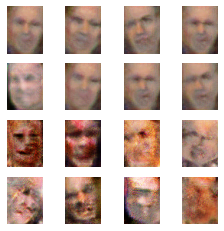

Epoch: 89,	 G Loss: -23.34579,	 D Loss: -6.48136,  D_Real_loss: -39.21770,  D_Fake_loss: 32.73634,	 G_fake_loss -31.53227,	 G_dist: 2.59622,	 G_pen: 8.18647


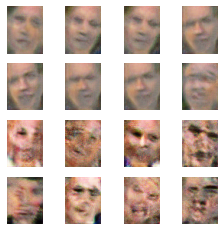

Epoch: 89,	 G Loss: 24.51202,	 D Loss: -6.80450,  D_Real_loss: 20.37148,  D_Fake_loss: -27.17598,	 G_fake_loss 24.51202,	 G_dist: 2.51622,	 G_pen: 0.00000


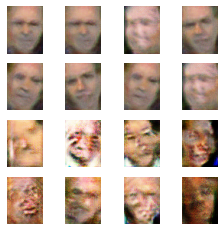

Epoch: 89,	 G Loss: 32.05352,	 D Loss: -8.91774,  D_Real_loss: 23.54142,  D_Fake_loss: -32.45916,	 G_fake_loss 32.05352,	 G_dist: 2.61821,	 G_pen: 0.00000


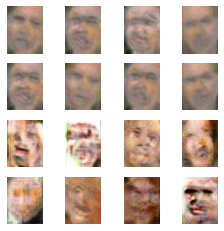

Epoch: 89,	 Generator Loss: 36.95246124267578,	 Discriminator Loss: -10.151620864868164
Total time to epoch 90 is 118.23622196912766 min
Epoch: 90,	 G Loss: 28.99281,	 D Loss: -10.96279,  D_Real_loss: 18.31234,  D_Fake_loss: -29.27513,	 G_fake_loss 28.99281,	 G_dist: 2.58968,	 G_pen: 0.00000


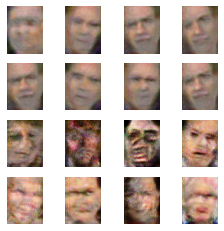

Epoch: 90,	 G Loss: 16.22882,	 D Loss: -8.88130,  D_Real_loss: 6.67549,  D_Fake_loss: -15.55679,	 G_fake_loss 16.22882,	 G_dist: 2.62389,	 G_pen: 0.00000


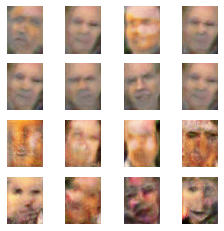

Epoch: 90,	 G Loss: 25.91873,	 D Loss: -12.69084,  D_Real_loss: 16.76387,  D_Fake_loss: -29.45471,	 G_fake_loss 25.91873,	 G_dist: 2.61410,	 G_pen: 0.00000


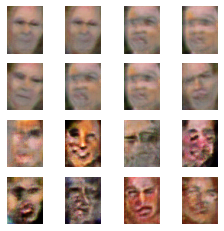

Epoch: 90,	 G Loss: 37.20927,	 D Loss: -8.75704,  D_Real_loss: 31.49372,  D_Fake_loss: -40.25076,	 G_fake_loss 37.20927,	 G_dist: 2.59965,	 G_pen: 0.00000


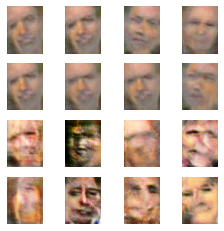

Epoch: 91,	 G Loss: 38.03130,	 D Loss: -5.36057,  D_Real_loss: 30.39103,  D_Fake_loss: -35.75160,	 G_fake_loss 38.03130,	 G_dist: 2.64970,	 G_pen: 0.00000


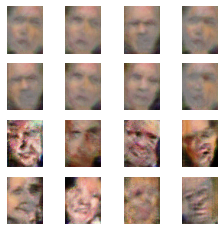

Epoch: 91,	 G Loss: 81.10113,	 D Loss: -6.17192,  D_Real_loss: 74.30878,  D_Fake_loss: -80.48070,	 G_fake_loss 81.10113,	 G_dist: 2.58778,	 G_pen: 0.00000


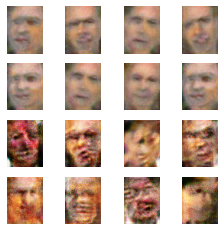

Epoch: 91,	 G Loss: 50.64462,	 D Loss: -7.32386,  D_Real_loss: 41.09698,  D_Fake_loss: -48.42085,	 G_fake_loss 50.64462,	 G_dist: 2.64865,	 G_pen: 0.00000


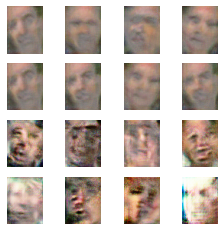

Epoch: 91,	 G Loss: 43.56697,	 D Loss: -6.01745,  D_Real_loss: 39.05214,  D_Fake_loss: -45.06959,	 G_fake_loss 43.56697,	 G_dist: 2.57548,	 G_pen: 0.00000


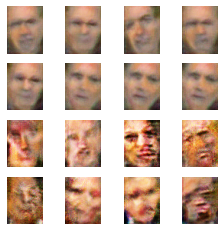

Epoch: 92,	 G Loss: 26.90166,	 D Loss: -6.18174,  D_Real_loss: 19.78705,  D_Fake_loss: -25.96878,	 G_fake_loss 26.90166,	 G_dist: 2.64635,	 G_pen: 0.00000


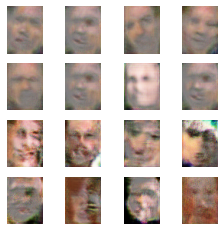

Epoch: 92,	 G Loss: 17.57890,	 D Loss: -5.41649,  D_Real_loss: 12.54388,  D_Fake_loss: -17.96037,	 G_fake_loss 17.57890,	 G_dist: 2.60791,	 G_pen: 0.00000


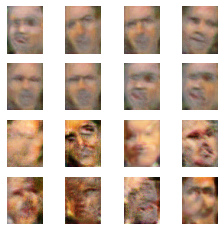

Epoch: 92,	 G Loss: 57.28460,	 D Loss: -7.10627,  D_Real_loss: 48.89220,  D_Fake_loss: -55.99847,	 G_fake_loss 57.28460,	 G_dist: 2.60342,	 G_pen: 0.00000


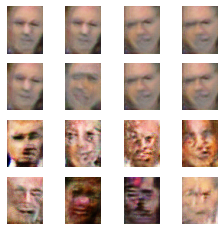

Epoch: 92,	 G Loss: 13.78958,	 D Loss: -6.67713,  D_Real_loss: 3.52555,  D_Fake_loss: -10.20268,	 G_fake_loss 13.78957,	 G_dist: 2.65549,	 G_pen: 0.00000


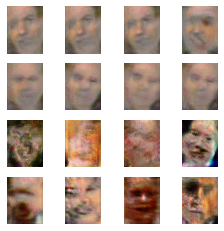

Epoch: 93,	 G Loss: 27.32752,	 D Loss: -5.65739,  D_Real_loss: 21.72608,  D_Fake_loss: -27.38347,	 G_fake_loss 27.32752,	 G_dist: 2.54514,	 G_pen: 0.00000


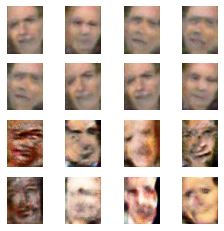

Epoch: 93,	 G Loss: 12.01043,	 D Loss: -6.33662,  D_Real_loss: 5.38092,  D_Fake_loss: -11.71754,	 G_fake_loss 12.01041,	 G_dist: 2.64804,	 G_pen: 0.00002


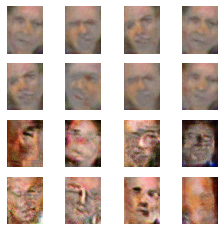

Epoch: 93,	 G Loss: 64.85987,	 D Loss: -4.41768,  D_Real_loss: 59.82927,  D_Fake_loss: -64.24695,	 G_fake_loss 64.85987,	 G_dist: 2.59481,	 G_pen: 0.00000


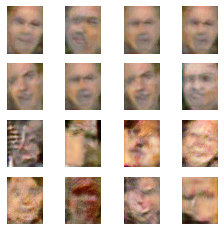

Epoch: 93,	 G Loss: 60.54114,	 D Loss: -5.97203,  D_Real_loss: 52.92638,  D_Fake_loss: -58.89841,	 G_fake_loss 60.54114,	 G_dist: 2.62864,	 G_pen: 0.00000


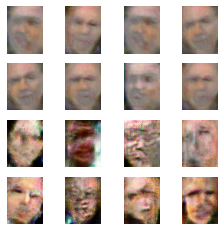

In [ ]:
# Define the model hyper-parameters either deterministically or
#   randomly for hyper-parameter fine tuning over multiple model runs. 
#%% Training Runs
training_runs = 1 #10
for run in range(training_runs):
  # UNCOMMENT TO MAKE SAMPLE DIRECTORY ON DISK
  #n = 1
  #while os.path.exists('./samples/run_{:04d}'.format(n)):
  #  n += 1
  sample_dir = './samples/'

  # UNCOMMENT TO MAKE SAMPLE DIRECTORY ON FILE TO DISK
  #os.mkdir(sample_dir) # guaranteed to not exist already
  tf.keras.backend.clear_session()
 
  # UNCOMMENT TO WRITE FILE TO DISK
  #file_write_location = shutil.copy(os.path.realpath(__file__), sample_dir[:-1])

  D_LR = 0.0001
  G_LR = 0.0001
  G_DROP = 0.45
  D_DROP = 0.00

  G_L1 = 256
  G_L2 = 128
  G_L3 = 64
  G_L4 = 32
  G_LAYER = [G_L1, G_L2, G_L3, G_L4]
  G_BN = True


  D_L1 = 256
  D_L2 = 128
  D_L3 = 64
  D_L4 = 32
  D_LAYER = [D_L1, D_L2, D_L3, D_L4]

  D_BN = False

  WGAN = True
  LAMBDA_GP = 10
  UPSAMPLE_CONV = True
  D_LABEL_SMOOTHING = np.random.uniform(0, 0.4) # does not apply to WGAN models

  DECAY_STEPS=3000
  DECAY_RATE=0.90


  g_lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
      G_LR, decay_steps=DECAY_STEPS, decay_rate=DECAY_RATE, staircase=False)

  d_lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
      D_LR, decay_steps=DECAY_STEPS, decay_rate=DECAY_RATE, staircase=False)

  generator_optimizer = tf.keras.optimizers.Adam(learning_rate=g_lr_schedule)
  discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=d_lr_schedule)

  generator=make_generator(G_LAYER, G_DROP, G_BN)
  discriminator=make_discriminator(D_LAYER, D_DROP, D_BN)
  tf.keras.backend.clear_session() #This does nothing?


  print("Batches per epoch: {}".format(NUM_SAMPLES//BATCH_SIZE))
  print("WGAN: ", WGAN)
  print("Upsample_conv: ", UPSAMPLE_CONV)
  print('G_LR: {}, D_LR: {}'.format(G_LR, D_LR))
  print('G_layers: {}'.format(G_LAYER))
  print('D_layers: {}'.format(D_LAYER))
  print('G_BN: {}, D_BN: {}'.format(G_BN, D_BN))
  print('G_DROP: {}, D_DROP: {}'.format(G_DROP, D_DROP))
  if not WGAN: #label smoothing not on for WGAN models
    print('Label Smoothing: {}'.format(D_LABEL_SMOOTHING))
  print('Lambda gp: {}'.format(LAMBDA_GP))


  # UNCOMMENT TO WRITE MODEL HYPER-PARAMS TO CSV FILE ON DISK
  #out_list = [WGAN, G_LR, D_LR, G_L1, G_L2, G_L3, D_L1, D_L2, D_L3, D_L4,
  #            G_BN, D_BN, G_DROP, D_DROP,
  #            DECAY_STEPS, DECAY_RATE, D_LABEL_SMOOTHING, UPSAMPLE_CONV, LAMBDA_GP, G_L4]
  #out_string = ''
  #for i in out_list:
  #  out_string += str(i) +', '

  #with open(sample_dir + 'hyperparams.txt', 'w') as file:
  #  file.write("WGAN, G_LR, D_LR, G_L1, G_L2, G_L3, D_L1, D_L2, D_L3, D_L4, G_BN, D_BN, G_DROP, D_DROP, DECAY_STEPS, DECAY_RATE, D_LABEL_SMOOTHING, UPSAMPLE_CONV, LAMBDA_GP, G_L4\n")
  #  file.write(out_string)


  # train_step must be defined here if hyper-parameters are changed between training runs 
  @tf.function
  def train_step(images):
    # This function is mostly code from Tensorflow, 
    #   except for the noise and dropout related parts
    noise = tf.random.normal([BATCH_SIZE, NOISE_DIM])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)
      generated_images_real = generator(noise, training=False)

      stddev_noise = 0.25*(0.9**tf.cast(checkpoint.step//(10*NUM_SAMPLES//BATCH_SIZE), tf.float32))
      image_noise = tf.random.normal(shape=images.shape, stddev=stddev_noise)
      images1 = tf.add(images, image_noise)
      real_output = discriminator(images1, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss, gen_loss_fake, gen_dist, gen_penalty = custom_generator_loss(fake_output, generated_images_real)
      disc_loss_real, disc_loss_fake, disc_loss = custom_discriminator_loss(real_output, fake_output)

      if WGAN:
        #gp = gradient_penalty(discriminator, images1, generated_images)
        grad_penalty = custom_gradient_penalty(discriminator, images1, generated_images)
        disc_loss_gp = disc_loss + LAMBDA_GP*grad_penalty

    if WGAN:
      gradients_of_discriminator = disc_tape.gradient(disc_loss_gp, discriminator.trainable_variables)
    else:
      gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))

    if WGAN:
      # UPDATE D two more times per iteration
      noise = tf.random.normal([BATCH_SIZE, NOISE_DIM])

      with tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        stddev_noise = 0.25*(0.9**tf.cast(checkpoint.step//(10*NUM_SAMPLES//BATCH_SIZE), tf.float32))
        image_noise = tf.random.normal(shape=images.shape, stddev=stddev_noise)
        images1 = tf.add(images, image_noise)
        real_output = discriminator(images1, training=True)
        fake_output = discriminator(generated_images, training=True)

        disc_loss_real, disc_loss_fake, disc_loss = custom_discriminator_loss(real_output, fake_output)

        grad_penalty = custom_gradient_penalty(discriminator, images1, generated_images)
        disc_loss_gp = disc_loss + LAMBDA_GP*grad_penalty
      gradients_of_discriminator = disc_tape.gradient(disc_loss_gp, discriminator.trainable_variables)
      discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

      noise = tf.random.normal([BATCH_SIZE, NOISE_DIM])
      with tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        stddev_noise = 0.25*(0.9**tf.cast(checkpoint.step//(10*NUM_SAMPLES//BATCH_SIZE), tf.float32))
        image_noise = tf.random.normal(shape=images.shape, stddev=stddev_noise)
        images1 = tf.add(images, image_noise)
        real_output = discriminator(images1, training=True)
        fake_output = discriminator(generated_images, training=True)

        disc_loss_real, disc_loss_fake, disc_loss = custom_discriminator_loss(real_output, fake_output)

        grad_penalty = custom_gradient_penalty(discriminator, images1, generated_images)
        disc_loss_gp = disc_loss + LAMBDA_GP*grad_penalty
      gradients_of_discriminator = disc_tape.gradient(disc_loss_gp, discriminator.trainable_variables)
      discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss, disc_loss_real, disc_loss_fake, gen_loss_fake, gen_dist, gen_penalty

  # UNCOMMENT TO WRITE CHECKPOINTS TO SAMPLE DIRECTORY ON DISK
  #checkpoint_dir = sample_dir
  #checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
  checkpoint = tf.train.Checkpoint(step=tf.Variable(0, dtype=tf.int64),
                                   generator_optimizer=generator_optimizer,
                                   discriminator_optimizer=discriminator_optimizer,
                                   generator=generator,
                                   discriminator=discriminator)

  # UNCOMMENT TO WRITE CHECKPOINTS TO SAMPLE DIRECTORY ON DISK
  #manager = tf.train.CheckpointManager(checkpoint, checkpoint_dir, max_to_keep=1)
  tf.summary.experimental.set_step(checkpoint.step)

  # IMPROVEMENT 3: WGAN LOSS WITH GP:
  def custom_discriminator_loss(critic_output_real, critic_output_fake):
    """
    In the conventional GAN (loss) structure the Generator tries to create
    images that appear real, and the discriminator tries to classify unlabeled
    sets of real an generated images as respectively real and fake.
    In a Wasserstein GAN, instead of attempting a binary classification of images,
    the discriminator, typically refered to as the 'critic' in Wasserstein GANs,
    """
    # Minimize total loss:
    #   total loss = real_loss + fake_loss
    #   total loss = -1*avg(real critique) + avg(fake critique)
    #   want to maximize the real crique value, and minimize the fake critique value
    #   equivalently to seperate the real and fake critique values as much as possible.
    #   Note these values are unbounded

    real_loss = -1 * tf.reduce_mean(critic_output_real) # maximize the real output
    fake_loss = tf.reduce_mean(critic_output_fake)
    total_loss = real_loss + fake_loss
    return real_loss, fake_loss, total_loss

  def custom_generator_loss(critic_output_fake, generated_images_eval, custom_mode_collapse_penalty=True):
    """
    WGAN generator loss is negative descriminator fake loss.
    I added a custom penalty, which you can turn on/off here. 
    """
    # Generator wants to minimize negative(avg(fake critique))
    #   which means to maximize the fake critique value
    #   this pushes that fake critique value towards the real critique value
    #

    if custom_mode_collapse_penalty:
      batch_average = tf.reduce_mean(generated_images_eval, axis=0, keepdims=True)
      avg_distance = tf.reduce_mean(tf.abs(generated_images_eval - batch_average))
      spread = 1 - avg_distance
      dist = (1 + spread)**2 - 1
      fake_loss = -1*tf.reduce_mean(critic_output_fake)   # negative fake average over batch
      inverse_distance_penalty = (1 - tf.math.sigmoid(fake_loss))*tf.math.abs(fake_loss)*dist*0.1
      loss = fake_loss + inverse_distance_penalty
      return loss, fake_loss, dist, inverse_distance_penalty
    else:
      loss = -1* tf.reduce_mean(critic_output_fake)
      return loss, 0, 0, 0

  # WGAN Gradient Penalty
  def interpolated_sample(real_images, fake_images):
    """
    We're going to randomly sample a (1, 62, 47, 3) dim point inbetween
    each pair of real and fake images in the batch
    """
    # rnd_weight is dist to real image, and 1-(dist to the fake image)
    # note this MUST be tf.random rather than np.random
    rnd_weight = tf.random.uniform(shape=(BATCH_SIZE,1,1,1))
    rnd_sample = real_images*rnd_weight + fake_images*(1-rnd_weight)

    return rnd_sample

  def custom_gradient_penalty(discriminator_model, real_images, fake_images):
    """
    See Improved Training of Wasserstein GANs:
    https://arxiv.org/pdf/1704.00028.pdf
    """

    rnd_sample = interpolated_sample(real_images, fake_images)
    with tf.GradientTape() as tf_gradient_watcher:
      tf_gradient_watcher.watch(rnd_sample)
      sample_critique = discriminator_model(rnd_sample)
    gradient_wrt_sample = tf_gradient_watcher.gradient(sample_critique, rnd_sample)
    # now we take the l2 norm, subtract 1, then square
    gradient_flattened = tf.reshape(gradient_wrt_sample, shape=(BATCH_SIZE, -1))

    # axis is 1 in the following norm because we want to norm actross examples not atch
    gradient_norm = tf.norm(gradient_flattened, ord='euclidean', axis=1) #equiv to np.norm
    gradient_penalty = tf.math.square(gradient_norm -1)

    #flatten the gradient penalty to a constant:
    gradient_penalty = tf.reduce_mean(gradient_penalty) # equiv to np.mean

    return gradient_penalty

  if WGAN:
    ### FROM   https://github.com/LynnHo/DCGAN-LSGAN-WGAN-GP-DRAGAN-Tensorflow-2/blob/master/train.py
    def discriminator_loss(real_output, fake_output):
      real_loss = 0
      fake_loss = 0
      real_loss = -tf.reduce_mean(real_output) # negative real avg over batch
      fake_loss = tf.reduce_mean(fake_output)#  #fake average over batch
      loss = fake_loss + real_loss
      return real_loss, fake_loss, loss

    def generator_loss(fake_output, generated_images):
      batch_average = tf.reduce_mean(generated_images, axis=0, keepdims=True)
      avg_distance = tf.reduce_mean(tf.abs(generated_images - batch_average))
      spread = 1 - avg_distance
      dist = (1 + spread)**2  - 1
      fake_loss = 0
      fake_loss = -tf.reduce_mean(fake_output)

      inverse_distance_penalty = (1 - tf.math.sigmoid(fake_loss))*tf.math.abs(fake_loss)*dist*0.1
      loss = fake_loss + inverse_distance_penalty
      return loss, fake_loss, dist, inverse_distance_penalty

    def gradient_penalty(discriminator, real_images, fake_images):
    ### FROM   https://github.com/LynnHo/DCGAN-LSGAN-WGAN-GP-DRAGAN-Tensorflow-2/blob/master/train.py
      def _interpolate(a, b):
          shape = [tf.shape(a)[0]] + [1] * (a.shape.ndims - 1)
          alpha = tf.random.uniform(shape=shape, minval=0., maxval=1.)
          inter = a + alpha * (b - a)
          inter.set_shape(a.shape)
          return inter, alpha

      x, alpha = _interpolate(real_images, fake_images)
      with tf.GradientTape() as t:
          t.watch(x)
          pred = discriminator(x)
      grad = t.gradient(pred, x)
      norm = tf.norm(tf.reshape(grad, [tf.shape(grad)[0], -1]), axis=1) #axis is supposed to be 1.
      gp = tf.reduce_mean((norm - 1.)**2)
      return gp, x, alpha
  else:
    # standard GAN loss function
    def discriminator_loss(real_output, fake_output):
      cross_entropy_real = tf.keras.losses.BinaryCrossentropy(from_logits=True)
      cross_entropy_fake = tf.keras.losses.BinaryCrossentropy(from_logits=True, label_smoothing=D_LABEL_SMOOTHING)
      real_loss = cross_entropy_real( tf.ones_like(real_output), real_output)
      fake_loss = cross_entropy_fake( tf.zeros_like(fake_output), fake_output)
      total_loss = real_loss + fake_loss
      return real_loss, fake_loss, total_loss

    def generator_loss(fake_output, _irrelevant, _irrelevant2=None):
      cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
      return cross_entropy(tf.ones_like(fake_output), fake_output)

  # call the training function!
  train()
